In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import RandomizedSearchCV, GridSearchCV, KFold
from sklearn.svm import SVR
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from sklearn.decomposition import PCA
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import PolynomialFeatures
from sklearn.metrics import *
plt.style.use("bmh")
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)

# Third Engines Dataset

In this dataset, the analysis process will be similar to the previous 2 sets (FD001, FD002), feature engineering process might perhahps be more comparable to FD001, as in both datasets there was only one flight condition.

However, in this set of engines it is introduced the 2 possible fault cases scenario, which might insert further complexity in dataset analysis, and adds the fault classification process.

Dataset FD003 characteristics:

- 100 train units
- 100 test units
- One flight condition
- 2 Fault modes


In [2]:
%store -r df_train_3
%store -r df_test_3
%store -r df_RUL_3

In [3]:
df_train_3.head()

,ID,Cycle,operational_setting_1,operational_setting_2,operational_setting_3,sensor_measurement_1,sensor_measurement_2,sensor_measurement_3,sensor_measurement_4,sensor_measurement_5,sensor_measurement_6,sensor_measurement_7,sensor_measurement_8,sensor_measurement_9,sensor_measurement_10,sensor_measurement_11,sensor_measurement_12,sensor_measurement_13,sensor_measurement_14,sensor_measurement_15,sensor_measurement_16,sensor_measurement_17,sensor_measurement_18,sensor_measurement_19,sensor_measurement_20,sensor_measurement_21,sensor_measurement_22,sensor_measurement_23,RUL
0,1,1,-0.0005,0.0004,100.0,518.67,642.36,1583.23,1396.84,14.62,21.61,553.97,2387.96,9062.17,1.3,47.30,522.31,2388.01,8145.32,8.4246,0.03,391,2388,100.0,39.11,23.3537,NaN,NaN,258
1,1,2,0.0008,-0.0003,100.0,518.67,642.50,1584.69,1396.89,14.62,21.61,554.55,2388.00,9061.78,1.3,47.23,522.42,2388.03,8152.85,8.4403,0.03,392,2388,100.0,38.99,23.4491,NaN,NaN,257
2,1,3,-0.0014,-0.0002,100.0,518.67,642.18,1582.35,1405.61,14.62,21.61,554.43,2388.03,9070.23,1.3,47.22,522.03,2388.00,8150.17,8.3901,0.03,391,2388,100.0,38.85,23.3669,NaN,NaN,256
3,1,4,-0.0020,0.0001,100.0,518.67,642.92,1585.61,1392.27,14.62,21.61,555.21,2388.00,9064.57,1.3,47.24,522.49,2388.08,8146.56,8.3878,0.03,392,2388,100.0,38.96,23.2951,NaN,NaN,255
4,1,5,0.0016,0.0000,100.0,518.67,641.68,1588.63,1397.65,14.62,21.61,554.74,2388.04,9076.14,1.3,47.15,522.58,2388.03,8147.80,8.3869,0.03,392,2388,100.0,39.14,23.4583,NaN,NaN,254


In [4]:
df_test_3.head()

,ID,Cycle,operational_setting_1,operational_setting_2,operational_setting_3,sensor_measurement_1,sensor_measurement_2,sensor_measurement_3,sensor_measurement_4,sensor_measurement_5,sensor_measurement_6,sensor_measurement_7,sensor_measurement_8,sensor_measurement_9,sensor_measurement_10,sensor_measurement_11,sensor_measurement_12,sensor_measurement_13,sensor_measurement_14,sensor_measurement_15,sensor_measurement_16,sensor_measurement_17,sensor_measurement_18,sensor_measurement_19,sensor_measurement_20,sensor_measurement_21,sensor_measurement_22,sensor_measurement_23
0,1,1,-0.0017,-0.0004,100.0,518.67,641.94,1581.93,1396.93,14.62,21.58,554.56,2387.93,9048.65,1.3,47.09,521.89,2387.94,8133.48,8.3760,0.03,391,2388,100.0,39.07,23.4468,NaN,NaN
1,1,2,0.0006,-0.0002,100.0,518.67,642.02,1584.86,1398.90,14.62,21.58,554.10,2387.94,9046.53,1.3,47.08,521.85,2388.01,8137.44,8.4062,0.03,391,2388,100.0,39.04,23.4807,NaN,NaN
2,1,3,0.0014,-0.0003,100.0,518.67,641.68,1581.78,1391.92,14.62,21.58,554.41,2387.97,9054.92,1.3,47.15,522.10,2387.94,8138.25,8.3553,0.03,391,2388,100.0,39.10,23.4244,NaN,NaN
3,1,4,0.0027,0.0001,100.0,518.67,642.20,1584.53,1395.34,14.62,21.59,554.58,2387.94,9055.04,1.3,47.26,522.45,2387.96,8137.07,8.3709,0.03,392,2388,100.0,38.97,23.4782,NaN,NaN
4,1,5,-0.0001,0.0001,100.0,518.67,642.46,1589.03,1395.86,14.62,21.58,554.16,2388.01,9048.59,1.3,46.94,521.91,2387.97,8134.20,8.4146,0.03,391,2388,100.0,39.09,23.3950,NaN,NaN


In [5]:
df_RUL_3.head()

,RUL
0,44
1,51
2,27
3,120
4,101


### NaN values search

In [6]:
print("total number of rows TRAIN: ", df_train_3.shape[0], "\n",
     "total number of rows TEST: ", df_test_3.shape[0])
for df,i in zip([df_train_3, df_test_3], ["train dataset","test dataset"]):
    print(i ,"\n"*2,
          df.isnull().sum(), "\n"*3)

total number of rows TRAIN:  24720 
 total number of rows TEST:  16596
train dataset 

 ID                           0
Cycle                        0
operational_setting_1        0
operational_setting_2        0
operational_setting_3        0
sensor_measurement_1         0
sensor_measurement_2         0
sensor_measurement_3         0
sensor_measurement_4         0
sensor_measurement_5         0
sensor_measurement_6         0
sensor_measurement_7         0
sensor_measurement_8         0
sensor_measurement_9         0
sensor_measurement_10        0
sensor_measurement_11        0
sensor_measurement_12        0
sensor_measurement_13        0
sensor_measurement_14        0
sensor_measurement_15        0
sensor_measurement_16        0
sensor_measurement_17        0
sensor_measurement_18        0
sensor_measurement_19        0
sensor_measurement_20        0
sensor_measurement_21        0
sensor_measurement_22    24720
sensor_measurement_23    24720
RUL                          0
dtype: int64 

Discovered that, once again, both train and test datasets have no monitored values of Sensors 22 and 23

In [3]:
df_train_3.dropna(axis=1, inplace=True)
df_test_3.dropna(axis=1, inplace=True)

# Feature Analysis

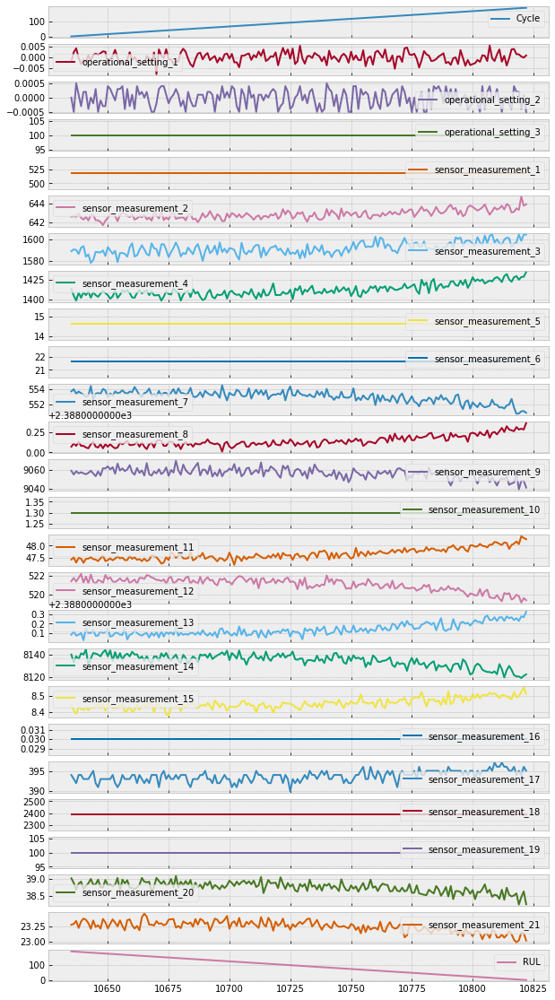

In [8]:
df_train_3[df_train_3.ID == 40].drop(columns=["ID"]).plot(subplots =True, figsize = (10,20));

Top 10 engines by maximum life achieved:

In [9]:
df_train_3[["ID","Cycle"]].groupby("ID").max(["Cycle"]).sort_values(by='Cycle', ascending=False).head(10)

,Cycle
ID,
55,525
24,494
96,491
10,481
34,459
18,447
7,424
71,409
9,406


If compared with first set of engines, it is appreciable that this dataset's engines reach important higher cycles

Average value for max cycles reached by engines:  247.2


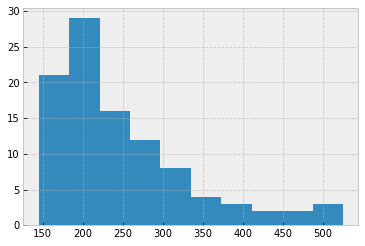

In [10]:
max_cycle_dataset_3 = df_train_3.groupby(["ID"])["Cycle"].max().reset_index()
max_cycle_dataset_3 = max_cycle_dataset_3.rename(columns={"Cycle":"Max_cycle"})
plt.hist(max_cycle_dataset_3["Max_cycle"])
print("Average value for max cycles reached by engines: ", max_cycle_dataset_3["Max_cycle"].mean())

The mean maximum life reached in this dataset is, consequently higher, compared to the 206 max cycle average from FD001. This difference in maximum life reached before failure might be determined due to the different fault cases

Text(0, 0.5, 'Max Cycle')

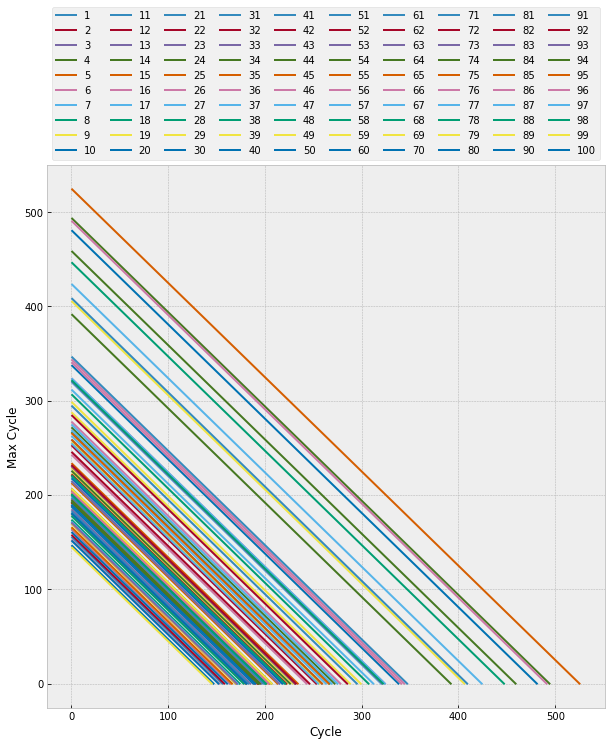

In [11]:
df_RUL_engine_3 = df_train_3[["ID","Cycle","RUL"]]
df_RUL_engine_3 = df_RUL_engine_3.pivot(index='Cycle', columns='ID', values='RUL')

df_RUL_engine_3.plot(figsize=(10, 10))
plt.legend(bbox_to_anchor=(0,1,1,1), loc=3,
       ncol=10, mode="expand")
plt.ylabel("Max Cycle")

Apparently in this graph is appreciable a slight separation between 2 groups of RUL lines. At this stage is difficult to confirm, but it could exist an engine set separation between Max cycle life above and below aprox 400 cyles

## Operational Settings Study

Max value for operational_setting_1: 0.0086 
 Min value for operational_setting_1: -0.0086 
 Average value for operational_setting_1: -2.3741909385112923e-05 

Max value for operational_setting_2: 0.0007 
 Min value for operational_setting_2: -0.0006 
 Average value for operational_setting_2: 5.068770226537184e-06 

Max value for operational_setting_3: 100.0 
 Min value for operational_setting_3: 100.0 
 Average value for operational_setting_3: 100.0 



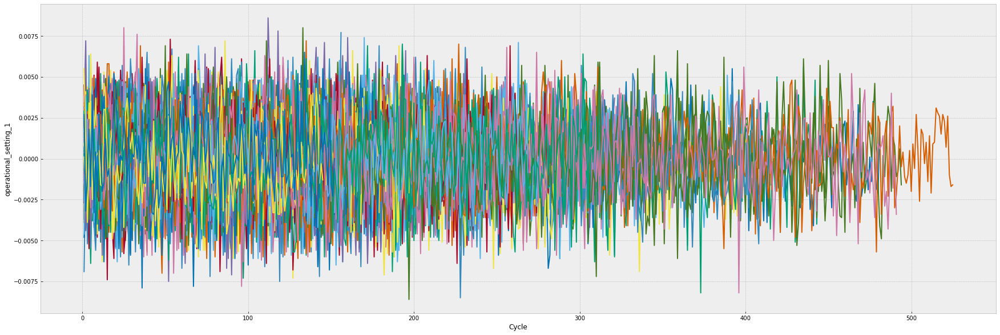

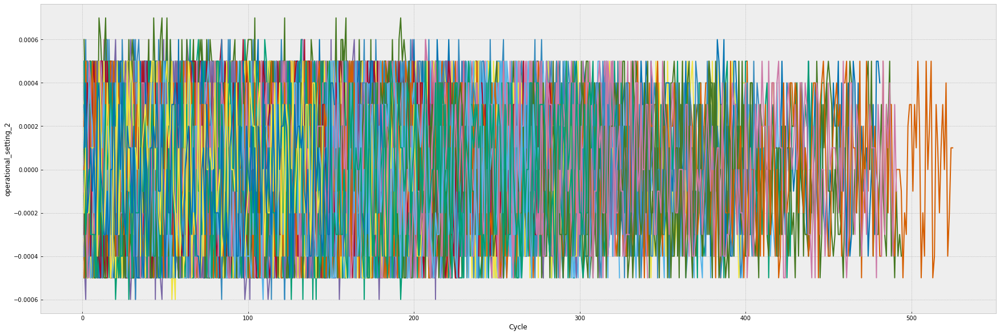

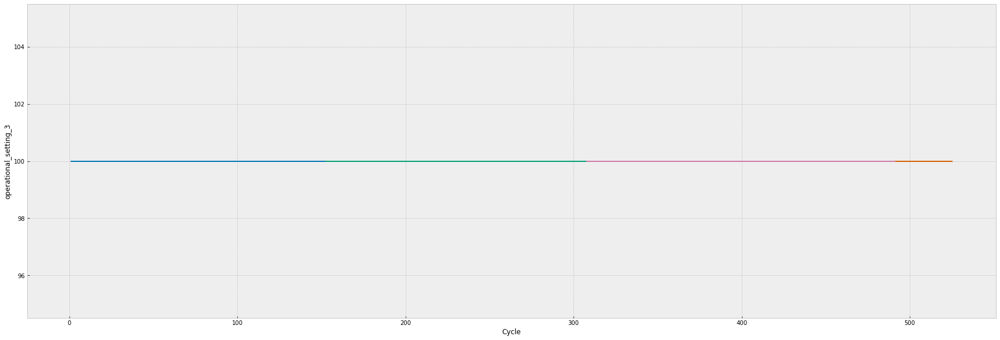

In [12]:
op_columns = ["operational_setting_1","operational_setting_2","operational_setting_3"]

for col in op_columns:
    print("Max value for {}:".format(col),df_train_3[col].max(), "\n",
         "Min value for {}:".format(col),df_train_3[col].min(), "\n",
        "Average value for {}:".format(col),df_train_3[col].mean(), "\n")
    
    df = df_train_3[["ID","Cycle",col]].pivot(index="Cycle", columns="ID", values=col)
    
    df.plot(figsize=(30,10), legend=None)
    plt.ylabel(str(col))

Similarly and due to the only flight condition existing in this set of engines, third operational setting appears constant for every engine, hence, it will be removed

Max value for operational_setting_1: 0.0083 
 Min value for operational_setting_1: -0.0087 
 Average value for operational_setting_1: -1.6847433116413627e-05 

Max value for operational_setting_2: 0.0006 
 Min value for operational_setting_2: -0.0006 
 Average value for operational_setting_2: -4.362496987225827e-06 

Max value for operational_setting_3: 100.0 
 Min value for operational_setting_3: 100.0 
 Average value for operational_setting_3: 100.0 



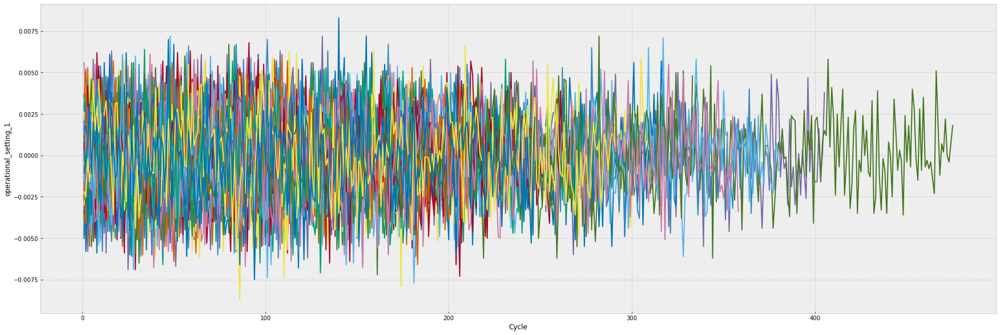

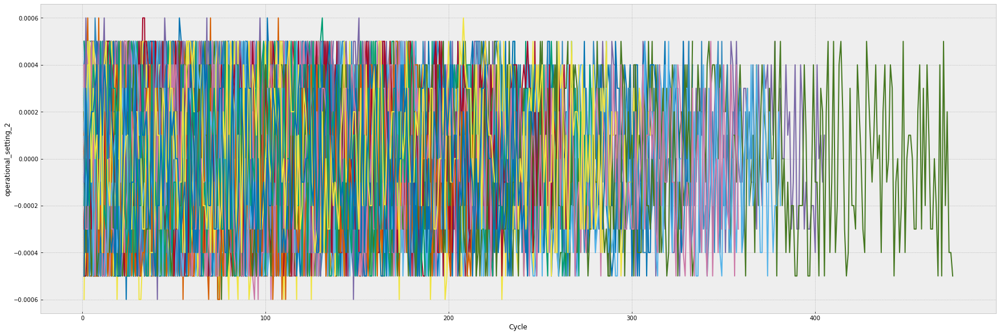

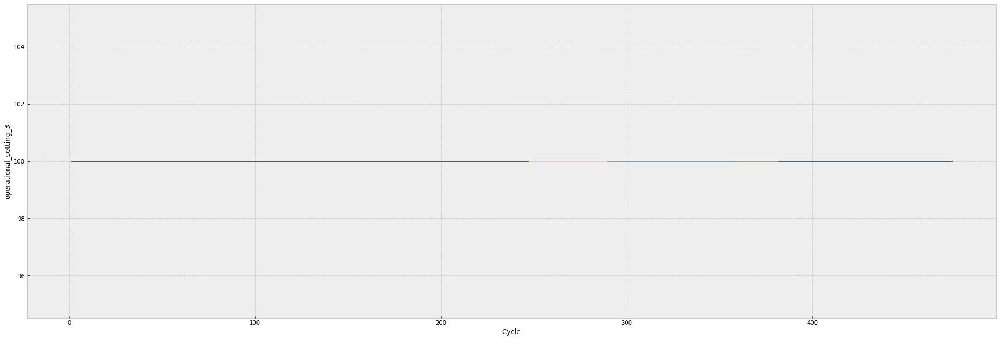

In [13]:
op_columns = ["operational_setting_1","operational_setting_2","operational_setting_3"]

for col in op_columns:
    print("Max value for {}:".format(col),df_test_3[col].max(), "\n",
         "Min value for {}:".format(col),df_test_3[col].min(), "\n",
        "Average value for {}:".format(col),df_test_3[col].mean(), "\n")
    
    df = df_test_3[["ID","Cycle",col]].pivot(index="Cycle", columns="ID", values=col)
    
    df.plot(figsize=(30,10), legend=None)
    plt.ylabel(str(col))

As expected, same behaviour for test dataset

In [14]:
df_train_3.drop("operational_setting_3", axis=1,inplace=True)
df_test_3.drop("operational_setting_3", axis=1,inplace=True)

Quick review of operational settings 1 and 2 for the entire set

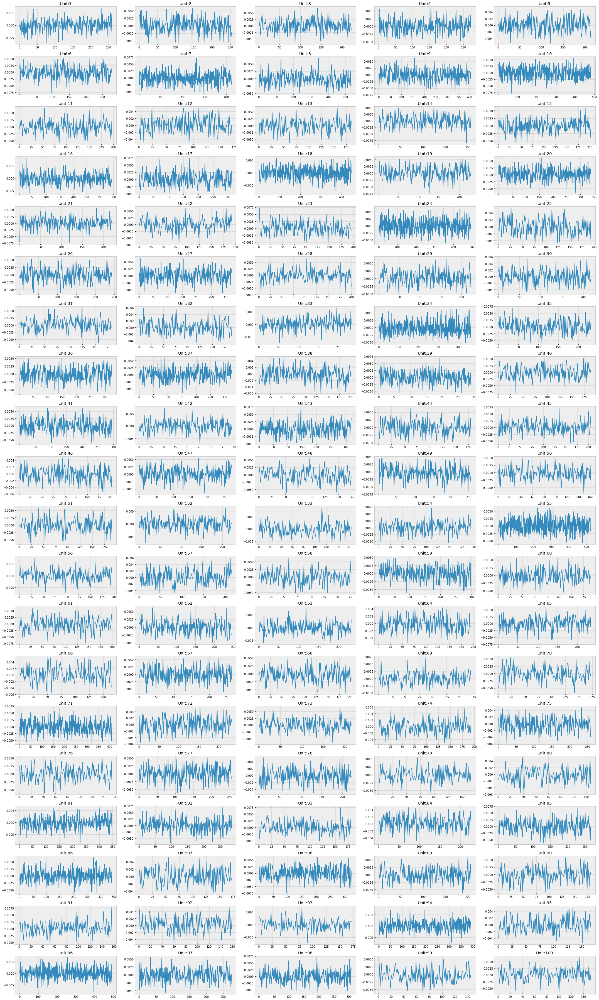

In [15]:
fig, ax = plt.subplots(nrows = 20, ncols = 5, figsize = (30,50))

ax = ax.ravel()

for i in range(0,100):
    sns.lineplot(data = df_train_3[df_train_3.ID == i+1], x = "Cycle", y = "operational_setting_1", ax = ax[i])
    ax[i].set_title("Unit:" + str(i+1))
    ax[i].set_xlabel("")
    ax[i].set_ylabel("")

plt.tight_layout()

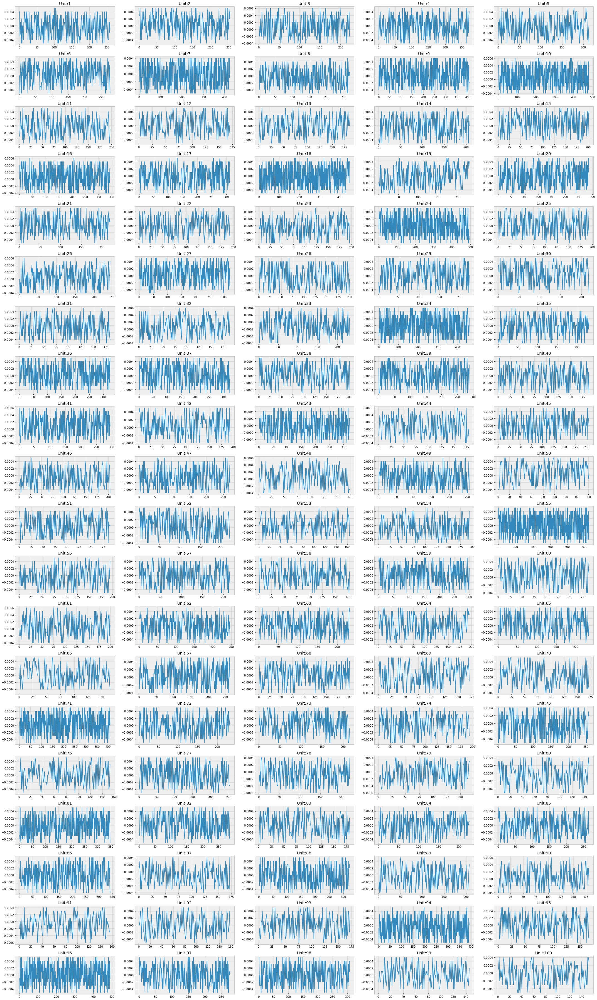

In [16]:
fig, ax = plt.subplots(nrows = 20, ncols = 5, figsize = (30,50))

ax = ax.ravel()

for i in range(0,100):
    sns.lineplot(data = df_train_3[df_train_3.ID == i+1], x = "Cycle", y = "operational_setting_2", ax = ax[i])
    ax[i].set_title("Unit:" + str(i+1))
    ax[i].set_xlabel("")
    ax[i].set_ylabel("")

plt.tight_layout()

## Sensor Measurement Analysis

Let's have a vision of each sensor's performance for a specific input engine

Write the unit engine number to get the sensor measurements: 12


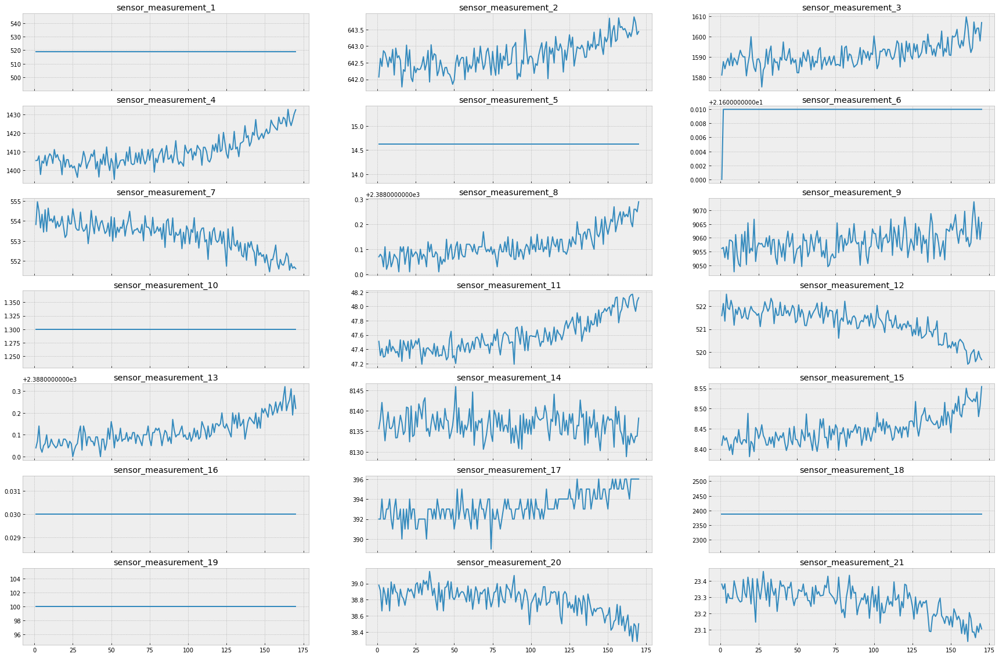

In [17]:
bfig,ax=plt.subplots(7,3,figsize=(30,20),sharex=True)

unit = input("Write the unit engine number to get the sensor measurements: ")
df_unit = df_train_3[df_train_3["ID"]==int(unit)]

contador = 0
for i in range(0,7):
    for j in range(0,3):
        ax[i,j].plot(df_unit["Cycle"], df_unit['sensor_measurement_'+str(contador+1)])
        ax[i,j].set_title('sensor_measurement_'+str(contador+1))
        contador+=1
        
plt.show()

At first sight it is already possible to identify sensors which do not change over the cycles of the engine input.

These will be automatically highlighted if the standard deviation is analysed

In [4]:
sensor_columns = df_train_3.columns[4:-1]
df_std_train = df_train_3.groupby(["ID"])[sensor_columns].std()
constant_sensors_train = []
for col in df_std_train:
    if df_std_train[col].mean()<1e-5:
        constant_sensors_train.append(col)
        
df_std_test = df_test_3.groupby(["ID"])[sensor_columns].std()
constant_sensors_test = []
for col in df_std_test:
    if df_std_test[col].mean()<1e-5:
        constant_sensors_test.append(col)

print("sensors constant through lifecycle in Train dataset: ","\n", constant_sensors_train, "\n"*2,
     "sensors constant through lifecycle in Test dataset: ", "\n",constant_sensors_test)

constant_sensors_train == constant_sensors_test

sensors constant through lifecycle in Train dataset:  
 ['operational_setting_3', 'sensor_measurement_1', 'sensor_measurement_5', 'sensor_measurement_16', 'sensor_measurement_18', 'sensor_measurement_19'] 

 sensors constant through lifecycle in Test dataset:  
 ['operational_setting_3', 'sensor_measurement_1', 'sensor_measurement_5', 'sensor_measurement_16', 'sensor_measurement_18', 'sensor_measurement_19']


True

In [19]:
for col in constant_sensors_train:    
    print(col, df_train_3[col].value_counts(), "\n",
         "proportion compared by entire dataset values of this sensor: ", 
          int(df_train_3[col].value_counts().values)*100/df_train_3.shape[0], "% \n")

sensor_measurement_1 518.67    24720
Name: sensor_measurement_1, dtype: int64 
 proportion compared by entire dataset values of this sensor:  100.0 % 

sensor_measurement_5 14.62    24720
Name: sensor_measurement_5, dtype: int64 
 proportion compared by entire dataset values of this sensor:  100.0 % 

sensor_measurement_16 0.03    24720
Name: sensor_measurement_16, dtype: int64 
 proportion compared by entire dataset values of this sensor:  100.0 % 

sensor_measurement_18 2388    24720
Name: sensor_measurement_18, dtype: int64 
 proportion compared by entire dataset values of this sensor:  100.0 % 

sensor_measurement_19 100.0    24720
Name: sensor_measurement_19, dtype: int64 
 proportion compared by entire dataset values of this sensor:  100.0 % 



Sensor measurement 10 does not appear in the list of low std, but its trend looks weird, so let's focus on it

In [20]:
print("sensor_measurement_10", df_train_3["sensor_measurement_10"].value_counts())

sensor_measurement_10 1.30    21814
1.31     2740
1.32      157
1.29        9
Name: sensor_measurement_10, dtype: int64


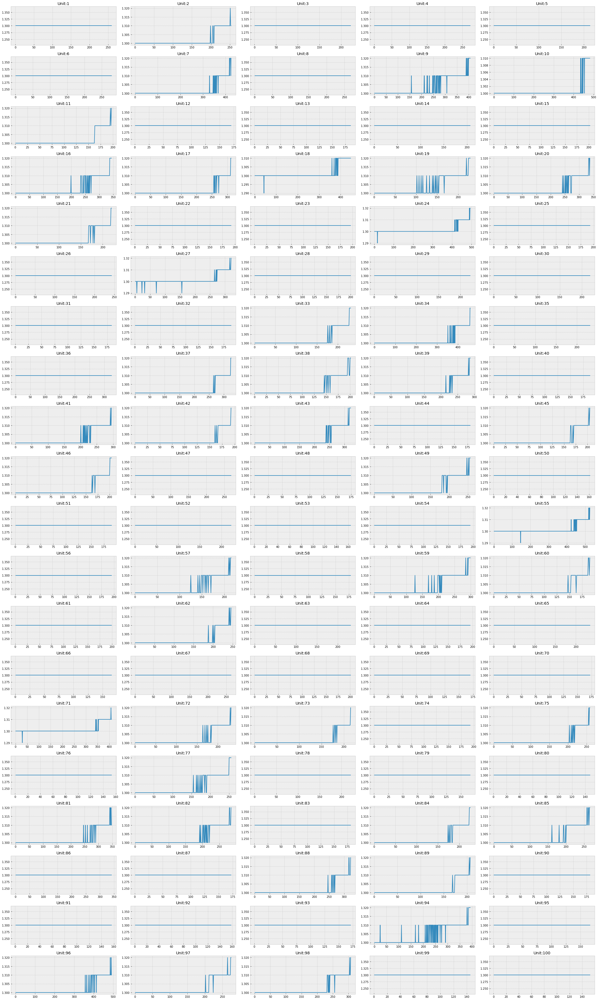

In [21]:
import seaborn as sns
fig, ax = plt.subplots(nrows = 20, ncols = 5, figsize = (30,50))

ax = ax.ravel()

for i in range(0,100):
    sns.lineplot(data = df_train_3[df_train_3.ID == i+1], x = "Cycle", y = "sensor_measurement_10", ax = ax[i])
    ax[i].set_title("Unit:" + str(i+1))
    ax[i].set_xlabel("")
    ax[i].set_ylabel("")

plt.tight_layout()

What it is found here is that sensor 10 presents 2 kinds of behaviour, one is completely constant and equal to 1.3, and the other one shows 2 increasing steps with some "toggling" along.

It seems it will somehow provide useful information for the fault class identification, but in this Notebook the purpose is to work with the regression problem, and as this sensor does not present any trend, it will be removed together with the previous mentioned sensors

In [5]:
df_train_3.drop(constant_sensors_train + ["sensor_measurement_10"],axis=1, inplace=True)
df_test_3.drop(constant_sensors_test + ["sensor_measurement_10"],axis=1, inplace=True)

Additionally, if the user has checked the sensor measurement set with several engines, it may have arrived at the fact that sensor 6 looks weird as well, let's plot some additional graphs with it

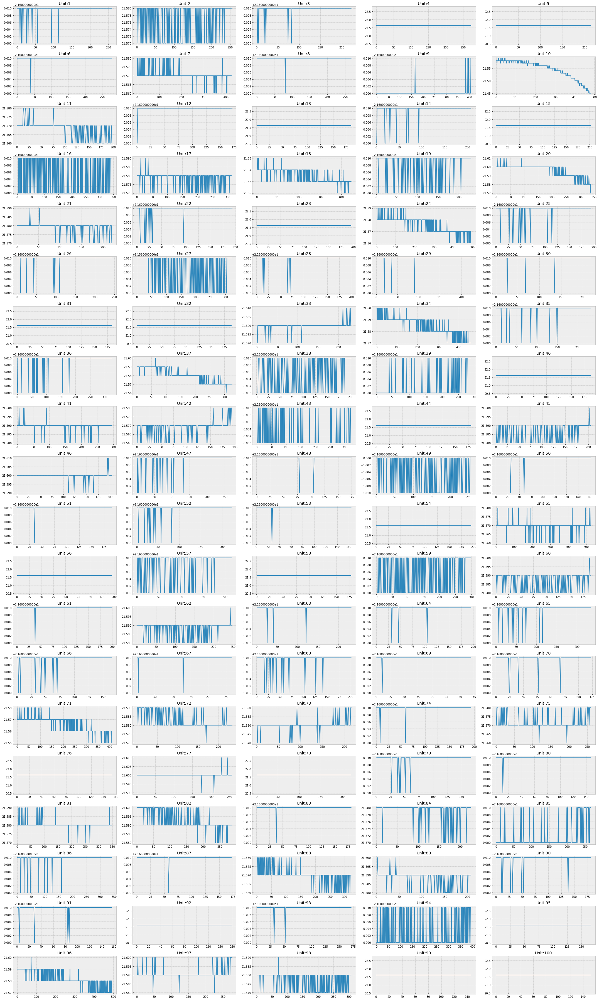

In [23]:
import seaborn as sns
fig, ax = plt.subplots(nrows = 20, ncols = 5, figsize = (30,50))

ax = ax.ravel()

for i in range(0,100):
    sns.lineplot(data = df_train_3[df_train_3.ID == i+1], x = "Cycle", y = "sensor_measurement_6", ax = ax[i])
    ax[i].set_title("Unit:" + str(i+1))
    ax[i].set_xlabel("")
    ax[i].set_ylabel("")

plt.tight_layout()

Due to the extreme toggling found in several engines, this sensor will be removed as well from the dataset

In [6]:
df_train_3.drop("sensor_measurement_6", axis=1, inplace=True)
df_test_3.drop("sensor_measurement_6", axis=1, inplace=True)

Correlation Matrix

In [7]:
corr_matrix = df_train_3.corr()
corr_matrix.style.background_gradient(cmap='coolwarm', vmin=-1, vmax=1,)

,ID,Cycle,operational_setting_1,operational_setting_2,sensor_measurement_2,sensor_measurement_3,sensor_measurement_4,sensor_measurement_7,sensor_measurement_8,sensor_measurement_9,sensor_measurement_11,sensor_measurement_12,sensor_measurement_13,sensor_measurement_14,sensor_measurement_15,sensor_measurement_17,sensor_measurement_20,sensor_measurement_21,RUL
ID,1.000000,-0.077196,-0.002637,-0.016477,0.021424,0.027339,0.024376,0.064626,0.050085,0.052341,0.029192,0.065447,0.048920,0.051634,-0.035267,0.027530,0.047705,0.046634,-0.077196
Cycle,-0.077196,1.000000,-0.003205,0.003410,0.300798,0.373506,0.361937,0.531015,0.438111,0.507838,0.407412,0.538197,0.437563,0.488564,-0.400594,0.386185,0.304585,0.311020,-0.482744
operational_setting_1,-0.002637,-0.003205,1.000000,0.001226,-0.002098,-0.004154,0.000811,-0.002498,-0.001344,-0.007728,-0.003287,-0.003288,-0.002467,-0.008939,0.007104,0.001679,-0.005606,-0.001452,0.003700
operational_setting_2,-0.016477,0.003410,0.001226,1.000000,0.005117,0.005186,0.004128,-0.002446,0.000628,0.012311,0.002195,-0.001333,-0.001413,0.015843,0.002108,0.003078,-0.001032,-0.003564,-0.001204
sensor_measurement_2,0.021424,0.300798,-0.002098,0.005117,1.000000,0.640503,0.745167,0.124167,0.533915,0.441283,0.762269,0.141785,0.532745,0.343954,0.232947,0.670062,-0.246286,-0.241318,-0.590564
sensor_measurement_3,0.027339,0.373506,-0.004154,0.005186,0.640503,1.000000,0.716890,0.282007,0.637926,0.535074,0.746093,0.298941,0.636513,0.454205,0.076820,0.677216,-0.091851,-0.089035,-0.624236
sensor_measurement_4,0.024376,0.361937,0.000811,0.004128,0.745167,0.716890,1.000000,0.181976,0.601272,0.509782,0.854030,0.202106,0.601254,0.404686,0.216773,0.749907,-0.235016,-0.230134,-0.657224
sensor_measurement_7,0.064626,0.531015,-0.002498,-0.002446,0.124167,0.282007,0.181976,1.000000,0.596510,0.579004,0.270774,0.988725,0.597169,0.601013,-0.826574,0.285796,0.802838,0.807138,-0.315048
sensor_measurement_8,0.050085,0.438111,-0.001344,0.000628,0.533915,0.637926,0.601272,0.596510,1.000000,0.578587,0.660209,0.608298,0.964052,0.519624,-0.238368,0.662618,0.241726,0.244548,-0.655345
sensor_measurement_9,0.052341,0.507838,-0.007728,0.012311,0.441283,0.535074,0.509782,0.579004,0.578587,1.000000,0.546839,0.590891,0.578325,0.954354,-0.287941,0.559109,0.263300,0.271765,-0.551843


In [8]:
corr_matrix_df = pd.DataFrame(corr_matrix.values, columns=corr_matrix.columns, index=corr_matrix.index)

high_correlated_features = []
for col in corr_matrix_df:
    correlated_cols = corr_matrix_df[col]
    pair_identified  = correlated_cols.apply(lambda x: abs(x)>0.9) # above this value it exists a High Correlation
    index_of_pair = correlated_cols[pair_identified].index
    
    for idx, corr in zip(index_of_pair, correlated_cols[pair_identified].values):
        high_correlated_features.append((col, idx, corr))
        
items_repeat = []
for i in high_correlated_features:
    if i[2] == 1:
        items_repeat.append(i)
        
detected_correlated_features = set(high_correlated_features).symmetric_difference(set(items_repeat))
detected_correlated_features 

{('sensor_measurement_12', 'sensor_measurement_7', 0.9887245144507938),
 ('sensor_measurement_13', 'sensor_measurement_8', 0.964051890406086),
 ('sensor_measurement_14', 'sensor_measurement_9', 0.954353847868631),
 ('sensor_measurement_7', 'sensor_measurement_12', 0.9887245144507938),
 ('sensor_measurement_8', 'sensor_measurement_13', 0.964051890406086),
 ('sensor_measurement_9', 'sensor_measurement_14', 0.954353847868631)}

It is then chosen sensors 7,8 and 14 to be dropped, as it has the lower correlation with the target variable

In [9]:
df_train_3_corr = df_train_3.drop(columns=["sensor_measurement_7","sensor_measurement_8","sensor_measurement_14"])
df_test_3_corr = df_test_3.drop(columns=["sensor_measurement_7","sensor_measurement_8","sensor_measurement_14"])

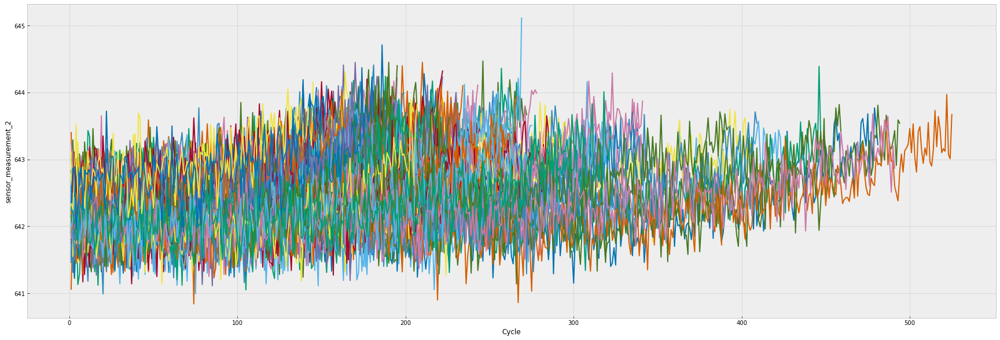

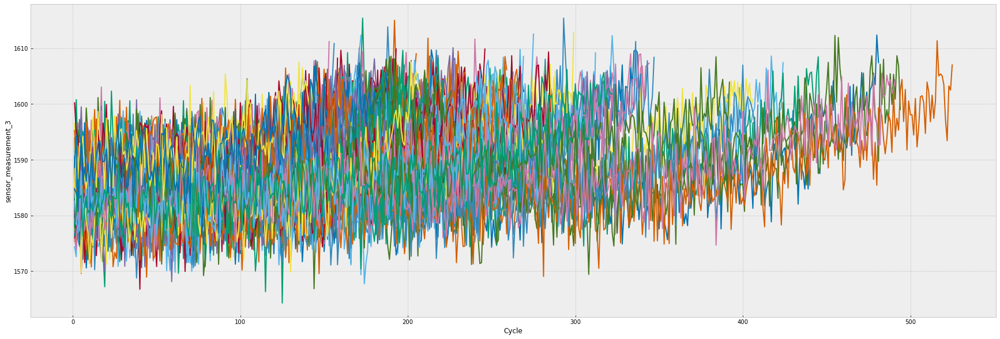

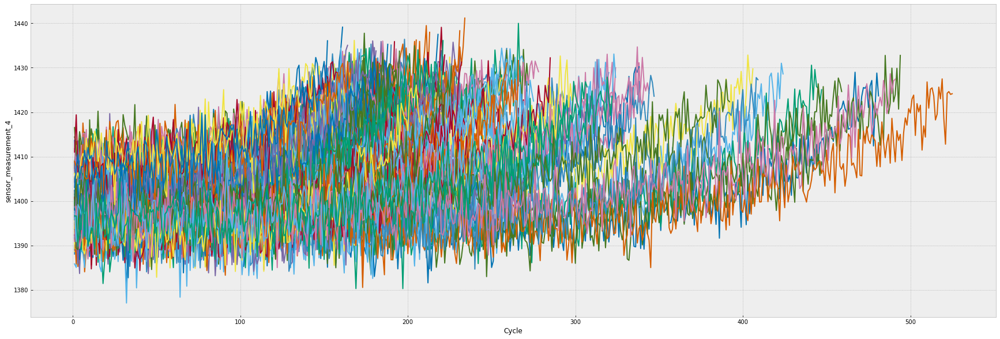

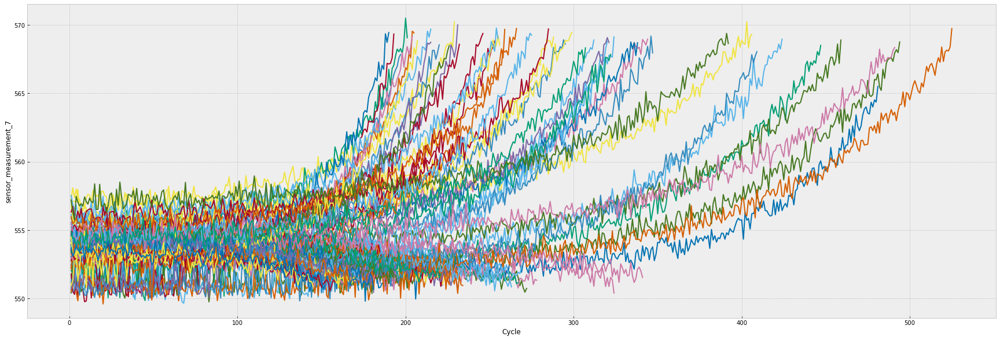

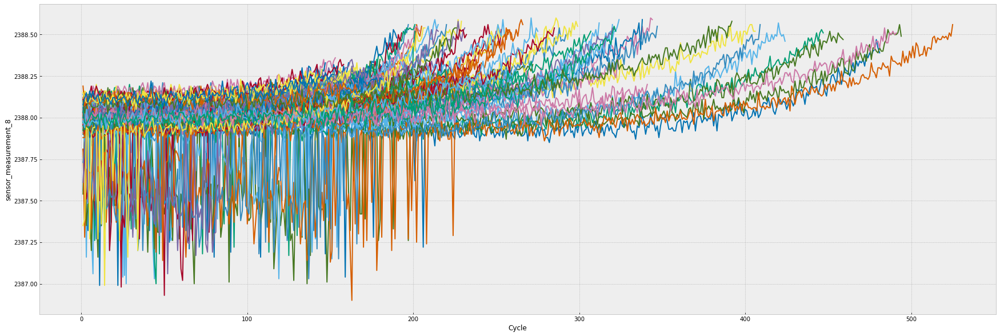

...

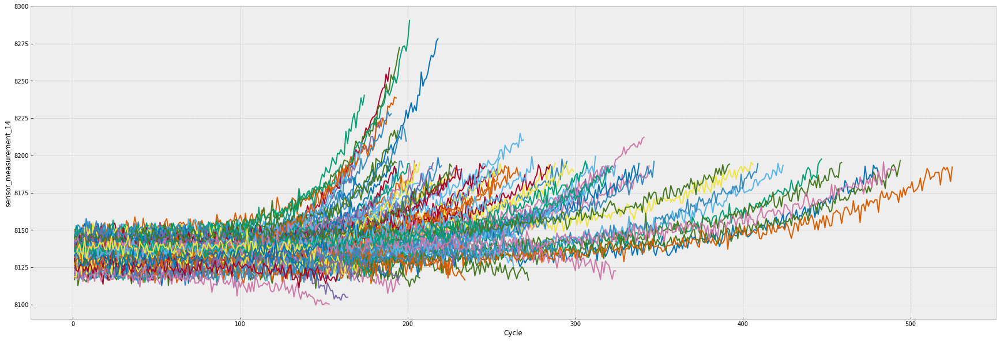

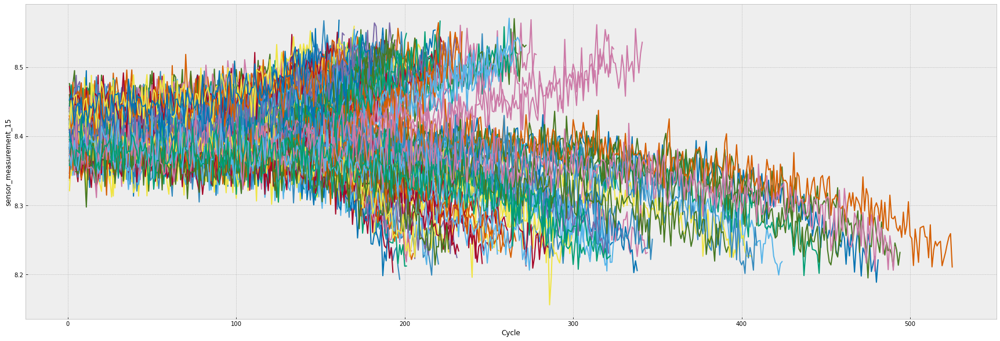

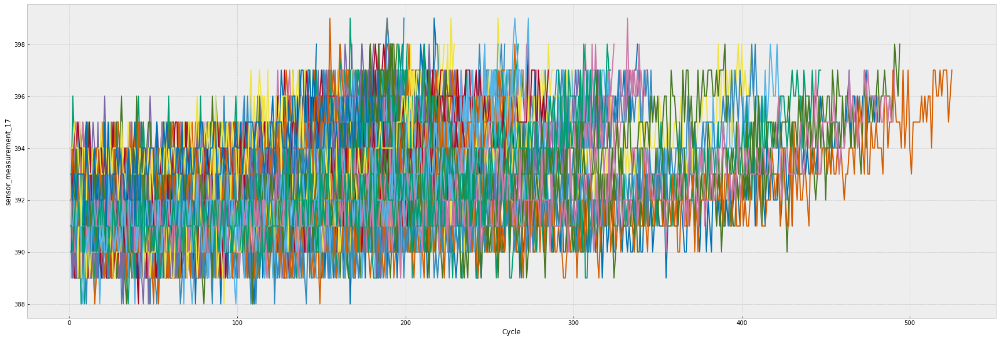

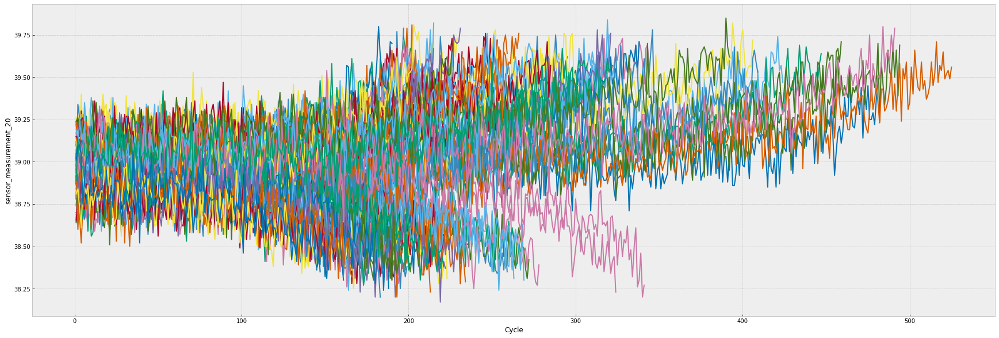

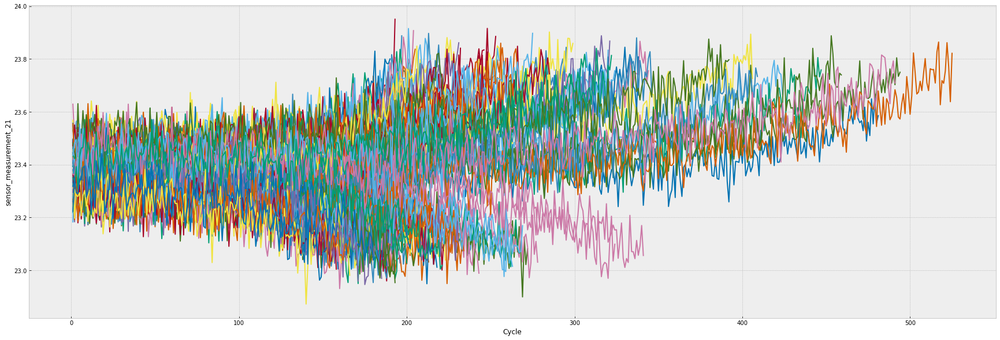

In [28]:
sensor_columns = df_train_3.columns[4:-1].tolist()
for col in sensor_columns:
    
    df = df_train_3[["ID","Cycle",col]].pivot(index="Cycle", columns="ID", values=col)
    df.plot(figsize=(30,10), legend=None)
    plt.ylabel(str(col))

# Baselines models

In [10]:
drop_cols = ["ID","Cycle"]
op_cols = ["operarional_setting_1","operarional_setting_2"]
X_train = df_train_3.drop(drop_cols+["RUL"], axis=1)
y_train = df_train_3["RUL"]
X_test = df_test_3.groupby("ID").last().reset_index().drop(drop_cols, axis=1)
y_test = df_RUL_3

In [30]:
lr = LinearRegression()
lr.fit(X_train, y_train)

preds_y_train = lr.predict(X_train)
print("TRAIN SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_train,preds_y_train), "\n",
      "MSE: ", mean_squared_error(y_train, preds_y_train), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_train, preds_y_train)), "\n",
      "R2 score: ", r2_score(y_train, preds_y_train))
lr_TR_score = r2_score(y_train, preds_y_train)

TRAIN SCORES - - - -  
 MAE:  36.50011700738105 
 MSE:  4050.697259929249 
 RMSE:  63.64508826240442 
 R2 score:  0.5854058011323031


In [31]:
preds_y_test = lr.predict(X_test)
print("TEST SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_test, preds_y_test), "\n",
      "MSE: ", mean_squared_error(y_test, preds_y_test), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_test, preds_y_test)), "\n",
      "R2 score: ", r2_score(preds_y_test, y_test))
lr_TS_score = r2_score(preds_y_test, y_test)

TEST SCORES - - - -  
 MAE:  40.94407033579773 
 MSE:  3344.6397242198223 
 RMSE:  57.8328602458829 
 R2 score:  0.3315100937562948


### Addition of y_clip

As studied in FD001, it is confirmed that clipping the RUL provides better results both in train and test datasets

In [32]:
clips = np.arange(100,185,5).tolist()
train_scores = []
test_scores = []
for clip in clips:
    
    y_train_clip = df_train_3["RUL"].clip(upper=clip)

    lr = LinearRegression()
    lr.fit(X_train, y_train_clip)
    preds_train = lr.predict(X_train)
    r2_tr = r2_score(y_train_clip, preds_train)
    train_scores.append(r2_tr)
    print(" TRAIN SCORE WITH {} upper clipped RUL: ".format(clip), r2_score(y_train_clip, preds_train))
    
    preds_test = lr.predict(X_test)
    r2_ts = r2_score(y_test, preds_test)
    test_scores.append(r2_ts)
    print(" TEST SCORE WITH {} upper clipped RUL: ".format(clip), r2_score(y_test, preds_test))

 TRAIN SCORE WITH 100 upper clipped RUL:  0.7399560565147123
 TEST SCORE WITH 100 upper clipped RUL:  0.6665301190795623
 TRAIN SCORE WITH 105 upper clipped RUL:  0.7418350230705326
 TEST SCORE WITH 105 upper clipped RUL:  0.6903286512738112
 TRAIN SCORE WITH 110 upper clipped RUL:  0.7427194379720753
 TEST SCORE WITH 110 upper clipped RUL:  0.7041799606912591
 TRAIN SCORE WITH 115 upper clipped RUL:  0.7428030957935234
 TEST SCORE WITH 115 upper clipped RUL:  0.7089574969427694
 TRAIN SCORE WITH 120 upper clipped RUL:  0.7421014201390592
 TEST SCORE WITH 120 upper clipped RUL:  0.7055392605212021
 TRAIN SCORE WITH 125 upper clipped RUL:  0.740833175180305
 TEST SCORE WITH 125 upper clipped RUL:  0.6947577924848426
 TRAIN SCORE WITH 130 upper clipped RUL:  0.7391059268201594
 TEST SCORE WITH 130 upper clipped RUL:  0.6773611824703205
 TRAIN SCORE WITH 135 upper clipped RUL:  0.736990149220889
 TEST SCORE WITH 135 upper clipped RUL:  0.6541623068265912
 TRAIN SCORE WITH 140 upper clippe

Train Score from max Test Score:  0.7428030957935234 
 Max Test Score:  0.7089574969427694 
 Achieved with 115 upper clipped RUL


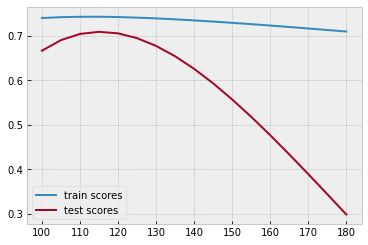

In [33]:
plt.plot(clips,train_scores,label="train scores")
plt.plot(clips, test_scores, label="test scores")
plt.legend()
mx_test = max(test_scores)
mx_idx = test_scores.index(mx_test)
train_mx_test = train_scores[mx_idx]
top_clip = clips[mx_idx]
print("Train Score from max Test Score: ", train_mx_test, "\n",
      "Max Test Score: ", mx_test, "\n",
     "Achieved with {} upper clipped RUL".format(top_clip))
lr_clipvar_TR_score = mx_test
lr_clipvar_TS_score = train_mx_test

### Random Forest Regressor

In [34]:
n_estimators = [int(x) for x in np.linspace(start = 10, stop = 100, num = 100)]

max_depth = [int(x) for x in np.linspace(10, 100, num = 10)]
min_samples_leaf = [int(x) for x in np.linspace(start = 1, stop = 10, num = 10)]

random_grid = {'n_estimators': n_estimators,
               'max_depth': max_depth,
              "min_samples_leaf":min_samples_leaf}
print(random_grid)

regr = RandomForestRegressor()
rf_random = RandomizedSearchCV(estimator=regr, param_distributions=random_grid, random_state=42)
rf_random.fit(X_train, y_train)

n_estimators = list(rf_random.best_params_.values())[0]
max_depth = list(rf_random.best_params_.values())[1]
min_samples_leaf = list(rf_random.best_params_.values())[2]

hyper_regr = RandomForestRegressor(n_estimators=n_estimators, max_depth=max_depth, min_samples_leaf=min_samples_leaf)
hyper_regr.fit(X_train, y_train)

{'n_estimators': [10, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100], 'max_depth': [10, 20, 30, 40, 50, 60, 70, 80, 90, 100], 'min_samples_leaf': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10]}


RandomForestRegressor(max_depth=5, min_samples_leaf=10, n_estimators=70)

In [35]:
rul_train_pred_rf = hyper_regr.predict(X_train)
print("RANDOM FOREST TRAIN SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_train, rul_train_pred_rf), "\n",
      "MSE: ", mean_squared_error(y_train, rul_train_pred_rf), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_train, rul_train_pred_rf)), "\n",
      "R2 score: ", r2_score(y_train, rul_train_pred_rf))
rf_TR_score = r2_score(y_train, rul_train_pred_rf)

RANDOM FOREST TRAIN SCORES - - - -  
 MAE:  29.38297105346294 
 MSE:  3651.2528245809067 
 RMSE:  60.42559742841527 
 R2 score:  0.626289465113723


In [36]:
rul_test_pred_rf = hyper_regr.predict(X_test)
print("RANDOM FOREST TEST SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_test, rul_test_pred_rf), "\n",
      "MSE: ", mean_squared_error(y_test, rul_test_pred_rf), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_test, rul_test_pred_rf)), "\n",
      "R2 score: ", r2_score(rul_test_pred_rf, y_test))
rf_TS_score = r2_score(rul_test_pred_rf, y_test)

RANDOM FOREST TEST SCORES - - - -  
 MAE:  27.968216906696803 
 MSE:  2483.470115798154 
 RMSE:  49.83442701384409 
 R2 score:  0.39962054518857615


#### Addition of RUL clipped to RF

In [37]:
clips = np.arange(100,185,5).tolist()
train_scores = []
test_scores = []
for clip in clips:
    
    y_train_clip = df_train_3["RUL"].clip(upper=clip)

    regr = RandomForestRegressor()
    rf_random = RandomizedSearchCV(estimator=regr, param_distributions=random_grid, random_state=42)
    rf_random.fit(X_train, y_train_clip)
    preds_train = rf_random.predict(X_train)
    
    r2_tr = r2_score(y_train_clip, preds_train)
    train_scores.append(r2_tr)
    print(" TRAIN SCORE WITH {} upper clipped RUL: ".format(clip), r2_score(y_train_clip, preds_train))
    
    preds_test = rf_random.predict(X_test)
    r2_ts = r2_score(y_test, preds_test)
    test_scores.append(r2_ts)
    print(" TEST SCORE WITH {} upper clipped RUL: ".format(clip), r2_score(y_test, preds_test))

 TRAIN SCORE WITH 100 upper clipped RUL:  0.9032522770821192
 TEST SCORE WITH 100 upper clipped RUL:  0.7114832224677968
 TRAIN SCORE WITH 105 upper clipped RUL:  0.9352949079330145
 TEST SCORE WITH 105 upper clipped RUL:  0.7308572500928833
 TRAIN SCORE WITH 110 upper clipped RUL:  0.8942918495211267
 TEST SCORE WITH 110 upper clipped RUL:  0.7455603838034657
 TRAIN SCORE WITH 115 upper clipped RUL:  0.8889775121499941
 TEST SCORE WITH 115 upper clipped RUL:  0.7475304696160692
 TRAIN SCORE WITH 120 upper clipped RUL:  0.9270606617380003
 TEST SCORE WITH 120 upper clipped RUL:  0.7460509803602347
 TRAIN SCORE WITH 125 upper clipped RUL:  0.8846950798421025
 TEST SCORE WITH 125 upper clipped RUL:  0.7338839357018943
 TRAIN SCORE WITH 130 upper clipped RUL:  0.8725428846082869
 TEST SCORE WITH 130 upper clipped RUL:  0.7038060938081194
 TRAIN SCORE WITH 135 upper clipped RUL:  0.8670851565033331
 TEST SCORE WITH 135 upper clipped RUL:  0.6896077424169964
 TRAIN SCORE WITH 140 upper clip

Train Score from max Test Score:  0.8889775121499941 
 Max Test Score:  0.7475304696160692 
 Achieved with 115 upper clipped RUL


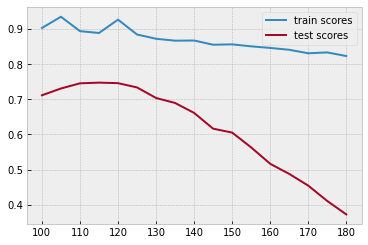

In [38]:
plt.plot(clips,train_scores,label="train scores")
plt.plot(clips, test_scores, label="test scores")
plt.legend()
mx_test = max(test_scores)
mx_idx = test_scores.index(mx_test)
train_mx_test = train_scores[mx_idx]
top_clip = clips[mx_idx]
print("Train Score from max Test Score: ", train_mx_test, "\n",
      "Max Test Score: ", mx_test, "\n",
     "Achieved with {} upper clipped RUL".format(top_clip))
rf_clipvar_TR_score = mx_test
rf_clipvar_TS_score = train_mx_test

### Support Vector Regressor

In [39]:
regr = make_pipeline(StandardScaler(), SVR(epsilon=0.2))
regr.fit(X_train, y_train)

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('svr', SVR(epsilon=0.2))])

In [40]:
svr_preds_train = regr.predict(X_train)
print("RANDOM FOREST TEST SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_train, svr_preds_train), "\n",
      "MSE: ", mean_squared_error(y_train, svr_preds_train), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_train, svr_preds_train)), "\n",
      "R2 score: ", r2_score(y_train, svr_preds_train))
svr_TR_score = r2_score(y_train, svr_preds_train)

RANDOM FOREST TEST SCORES - - - -  
 MAE:  25.178776595385344 
 MSE:  3964.8613053151516 
 RMSE:  62.96714464953252 
 R2 score:  0.5941912241233803


In [41]:
svr_preds_test = regr.predict(X_test)
print("RANDOM FOREST TEST SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_test, svr_preds_test), "\n",
      "MSE: ", mean_squared_error(y_test, svr_preds_test), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_test, svr_preds_test)), "\n",
      "R2 score: ", r2_score(svr_preds_test, y_test))
svr_TS_score = r2_score(svr_preds_test, y_test)

RANDOM FOREST TEST SCORES - - - -  
 MAE:  21.870196167408217 
 MSE:  1874.9823638697483 
 RMSE:  43.301066544252095 
 R2 score:  0.5123435004406899


#### Addition of RUL clipped to SVR

In [42]:
clips = np.arange(100,185,5).tolist()
train_scores = []
test_scores = []
for clip in clips:
    
    y_train_clip = df_train_3["RUL"].clip(upper=clip)

    svr = make_pipeline(StandardScaler(), SVR(epsilon=0.2))
    svr.fit(X_train, y_train_clip)
    preds_train = svr.predict(X_train)
    
    r2_tr = r2_score(y_train_clip, preds_train)
    train_scores.append(r2_tr)
    print(" TRAIN SCORE WITH {} upper clipped RUL: ".format(clip), r2_score(y_train_clip, preds_train))
    
    preds_test = svr.predict(X_test)
    r2_ts = r2_score(y_test, preds_test)
    test_scores.append(r2_ts)
    print(" TEST SCORE WITH {} upper clipped RUL: ".format(clip), r2_score(y_test, preds_test))

 TRAIN SCORE WITH 100 upper clipped RUL:  0.8556848003783719
 TEST SCORE WITH 100 upper clipped RUL:  0.7105716290811732
 TRAIN SCORE WITH 105 upper clipped RUL:  0.849634766849648
 TEST SCORE WITH 105 upper clipped RUL:  0.7278616811245213
 TRAIN SCORE WITH 110 upper clipped RUL:  0.8437499766203382
 TEST SCORE WITH 110 upper clipped RUL:  0.7347840534356809
 TRAIN SCORE WITH 115 upper clipped RUL:  0.8374749660067234
 TEST SCORE WITH 115 upper clipped RUL:  0.7311234696616022
 TRAIN SCORE WITH 120 upper clipped RUL:  0.8312179771954701
 TEST SCORE WITH 120 upper clipped RUL:  0.7193148718470019
 TRAIN SCORE WITH 125 upper clipped RUL:  0.8249869245699175
 TEST SCORE WITH 125 upper clipped RUL:  0.700427242594839
 TRAIN SCORE WITH 130 upper clipped RUL:  0.8187062711793238
 TEST SCORE WITH 130 upper clipped RUL:  0.6760792086316978
 TRAIN SCORE WITH 135 upper clipped RUL:  0.8123554642135811
 TEST SCORE WITH 135 upper clipped RUL:  0.6462262592925503
 TRAIN SCORE WITH 140 upper clippe

Train Score from max Test Score:  0.8437499766203382 
 Max Test Score:  0.7347840534356809 
 Achieved with 110 upper clipped RUL


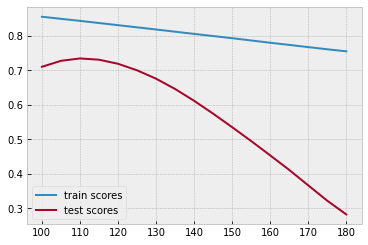

In [43]:
plt.plot(clips,train_scores,label="train scores")
plt.plot(clips, test_scores, label="test scores")
plt.legend()
mx_test = max(test_scores)
mx_idx = test_scores.index(mx_test)
train_mx_test = train_scores[mx_idx]
top_clip = clips[mx_idx]
print("Train Score from max Test Score: ", train_mx_test, "\n",
      "Max Test Score: ", mx_test, "\n",
     "Achieved with {} upper clipped RUL".format(top_clip))
svr_clipvar_TR_score = mx_test
svr_clipvar_TS_score = train_mx_test

# Top Features

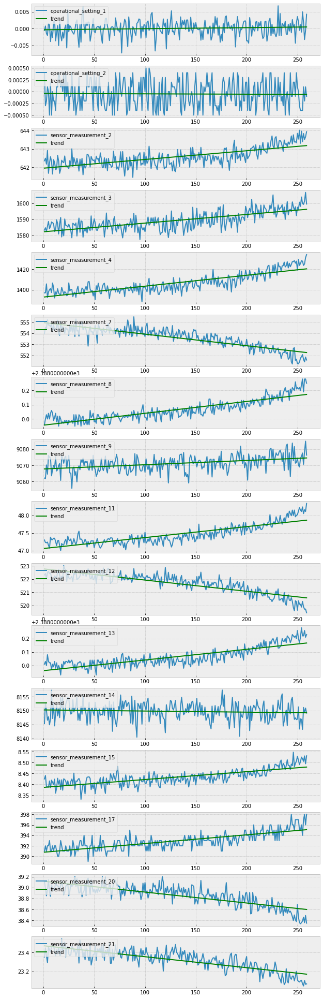

In [44]:
df_3 = df_train_3[df_train_3["ID"]==1]
x = df_3["Cycle"].values.reshape(-1,1)

cols = df_3.columns[2:-1]
fig, axes = plt.subplots(len(cols), 1, figsize=(10,35))
slopes = []
for col, ax in zip(cols, axes):
    linear = LinearRegression()
    y = df_3[col].values.reshape(-1,1)
    linear.fit(x,y)
    preds = linear.predict(x)
    ax.plot(x,y, label=col)
    ax.plot(x,preds,"g",label='trend')
    ax.legend(loc=2)
    slope = linear.coef_
    slopes.append(slope)

In [45]:
slopes_df = pd.DataFrame({"columns": cols, "slope":slopes})
slopes_df["slope"] = slopes_df["slope"].apply(lambda x: abs(x))
slopes_df.sort_values("slope", ascending=False)

,columns,slope
4,sensor_measurement_4,[[0.10685652122861423]]
3,sensor_measurement_3,[[0.05426640926640918]]
7,sensor_measurement_9,[[0.026266899662248197]]
13,sensor_measurement_17,[[0.016629944536921275]]
5,sensor_measurement_7,[[0.010389229249694376]]
9,sensor_measurement_12,[[0.008501143105794234]]
2,sensor_measurement_2,[[0.004739710321105683]]
11,sensor_measurement_14,[[0.003994695436555796]]
8,sensor_measurement_11,[[0.0031119414840345048]]
14,sensor_measurement_20,[[0.0019929272487412024]]


### Linear Regression + Top Features Variation + RUL upper clip

In [46]:
columns = slopes_df.sort_values("slope", ascending=False)["columns"].values.tolist()
column=[]

clips = np.arange(100,185,5).tolist()
best_test_score = []
best_train_score = []
lens_columns = []
top_clips = []
for col in columns:
    
    train_score = []
    test_score = []
    
    
    column.append(col) # the number of columns in the model will be one by one increasing
    
    df = df_train_3[["ID","Cycle"]+column]
    X_train_ = df.drop(columns=["ID","Cycle"], axis=1)    
    df_test = df_test_3[["ID", "Cycle"]+column]
    df_test_red = df_test.groupby("ID").last().reset_index()
    X_test = df_test_red.drop(columns=["ID","Cycle"], axis=1)
    y_test = df_RUL_3
    
    print(" Scores with {} top features: ".format(len(column)))
    
    for clip in clips:
        
        y_train = df_train_3["RUL"].clip(upper=clip)

        lr = LinearRegression()
        lr.fit(X_train_, y_train)

        preds_train = lr.predict(X_train_)
        r2_tr = r2_score(y_train, preds_train)
        train_scores.append(r2_tr)
          
        preds_test = lr.predict(X_test)
        r2_ts = r2_score(y_test, preds_test)
        test_scores.append(r2_ts)
        
        test_score.append(r2_ts)
        train_score.append(r2_tr)
              
    mx_test = max(test_score)
    mx_idx = test_score.index(mx_test)
    train_mx_test = train_score[mx_idx]
    top_clip = clips[mx_idx]
    print(" best metrics with {} top features: ".format(len(column)), "\n",
                                                       "train:",train_mx_test,"test",mx_test,
                                                       "with clip:", top_clip)
    best_test_score.append(mx_test)
    best_train_score.append(train_mx_test)
    lens_columns.append(len(column))

mx_best_test = max(best_test_score)
mx_idx_best = best_test_score.index(mx_best_test)
train_mx_best = best_train_score[mx_idx_best]
top_column = lens_columns[mx_idx_best]

print("\n"*3,
      "BEST METRICS for combination of top features and upper RUL clip: ",
     "\n", "Features number:", top_column,"\n",
     "Best Train Score: ", train_mx_best, " Best Test Score:", mx_best_test)

 Scores with 1 top features: 
 best metrics with 1 top features:  
 train: 0.5937470018099616 test 0.5229770453639471 with clip: 110
 Scores with 2 top features: 
 best metrics with 2 top features:  
 train: 0.6353532137423772 test 0.5531211405430084 with clip: 110
 Scores with 3 top features: 
 best metrics with 3 top features:  
 train: 0.696934120580551 test 0.6458387909227556 with clip: 115
 Scores with 4 top features: 
 best metrics with 4 top features:  
 train: 0.7093043056664127 test 0.6448597199492048 with clip: 115
 Scores with 5 top features: 
 best metrics with 5 top features:  
 train: 0.7116950468248598 test 0.6533443333764393 with clip: 115
 Scores with 6 top features: 
 best metrics with 6 top features:  
 train: 0.7119883932196984 test 0.653898928304676 with clip: 115
 Scores with 7 top features: 
 best metrics with 7 top features:  
 train: 0.7206230066034659 test 0.6766019809089241 with clip: 115
 Scores with 8 top features: 
 best metrics with 8 top features:  
 tra

It is achieved a combination between RUL clip of 115 and 10 top features with an increased metrics from baseline model, hence, for Linear Regression, 10 top features will be used from now on

### Random Forest + Top Features Variation + RUL upper clip

In [47]:
columns = slopes_df.sort_values("slope", ascending=False)["columns"].values.tolist()
column=[]

clips = np.arange(100,185,5).tolist()
best_test_score = []
best_train_score = []
lens_columns = []
top_clips = []
for col in columns:
    
    train_score = []
    test_score = []
    
    
    column.append(col) # the number of columns in the model will be one by one increasing
    
    df = df_train_3[["ID","Cycle"]+column]
    X_train = df.drop(columns=["ID","Cycle"], axis=1)    
    df_test = df_test_3[["ID", "Cycle"]+column]
    df_test_red = df_test.groupby("ID").last().reset_index()
    X_test = df_test_red.drop(columns=["ID","Cycle"], axis=1)
    y_test = df_RUL_3
    
    print(" Scores with {} top features: ".format(len(column)))
    
    for clip in clips:
        
        y_train = df_train_3["RUL"].clip(upper=clip)

        regr = RandomForestRegressor()
        rf_random = RandomizedSearchCV(estimator=regr, param_distributions=random_grid, random_state=42)
        rf_random.fit(X_train, y_train)

        n_estimators = list(rf_random.best_params_.values())[0]
        max_depth = list(rf_random.best_params_.values())[1]
        min_samples_leaf = list(rf_random.best_params_.values())[2]

        hyper_regr = RandomForestRegressor(n_estimators=n_estimators, max_depth=max_depth, min_samples_leaf=min_samples_leaf)
        hyper_regr.fit(X_train, y_train)

        preds_train = hyper_regr.predict(X_train)
        r2_tr = r2_score(y_train, preds_train)
        train_scores.append(r2_tr)
          
        preds_test = hyper_regr.predict(X_test)
        r2_ts = r2_score(y_test, preds_test)
        test_scores.append(r2_ts)
        
        test_score.append(r2_ts)
        train_score.append(r2_tr)
              
    mx_test = max(test_score)
    mx_idx = test_score.index(mx_test)
    train_mx_test = train_score[mx_idx]
    top_clip = clips[mx_idx]
    print(" best metrics with {} top features: ".format(len(column)), "\n",
                                                       "train:",train_mx_test,"test",mx_test,
                                                       "with clip:", top_clip)
    best_test_score.append(mx_test)
    best_train_score.append(train_mx_test)
    lens_columns.append(len(column))

mx_best_test = max(best_test_score)
mx_idx_best = best_test_score.index(mx_best_test)
train_mx_best = best_train_score[mx_idx_best]
top_column = lens_columns[mx_idx_best]

print("\n"*3,
      "BEST METRICS for combination of top features and upper RUL clip: ",
     "\n", "Features number:", top_column,"\n",
     "Best Train Score: ", train_mx_best, " Best Test Score:", mx_best_test)

 Scores with 1 top features: 
 best metrics with 1 top features:  
 train: 0.6542994520766126 test 0.5202274591582762 with clip: 115
 Scores with 2 top features: 
 best metrics with 2 top features:  
 train: 0.7318034854108957 test 0.5618382615859792 with clip: 110
 Scores with 3 top features: 
 best metrics with 3 top features:  
 train: 0.8293017110483075 test 0.6791627807727557 with clip: 110
 Scores with 4 top features: 
 best metrics with 4 top features:  
 train: 0.833491026069791 test 0.6845300178120606 with clip: 115
 Scores with 5 top features: 
 best metrics with 5 top features:  
 train: 0.8531838825360897 test 0.7143749203331533 with clip: 115
 Scores with 6 top features: 
 best metrics with 6 top features:  
 train: 0.8603881481942184 test 0.7406638403652372 with clip: 115
 Scores with 7 top features: 
 best metrics with 7 top features:  
 train: 0.8687694724130687 test 0.7330342832029964 with clip: 110
 Scores with 8 top features: 
 best metrics with 8 top features:  
 tr

### SVR + Top Features Variation

In [48]:
columns = slopes_df.sort_values("slope", ascending=False)["columns"].values.tolist()
column=[]

clips = np.arange(100,185,5).tolist()
best_test_score = []
best_train_score = []
lens_columns = []
top_clips = []
for col in columns:
    
    train_score = []
    test_score = []
    
    
    column.append(col) # the number of columns in the model will be one by one increasing
    
    df = df_train_3[["ID","Cycle"]+column]
    X_train = df.drop(columns=["ID","Cycle"], axis=1)    
    df_test = df_test_3[["ID", "Cycle"]+column]
    df_test_red = df_test.groupby("ID").last().reset_index()
    X_test = df_test_red.drop(columns=["ID","Cycle"], axis=1)
    y_test = df_RUL_3
    
    print(" Scores with {} top features: ".format(len(column)))
    
    for clip in clips:
        
        y_train = df_train_3["RUL"].clip(upper=clip)

        svr = make_pipeline(StandardScaler(), SVR(epsilon=0.2))
        svr.fit(X_train, y_train)

        preds_train = svr.predict(X_train)
        r2_tr = r2_score(y_train, preds_train)
        train_scores.append(r2_tr)
          
        preds_test = svr.predict(X_test)
        r2_ts = r2_score(y_test, preds_test)
        test_scores.append(r2_ts)
        
        test_score.append(r2_ts)
        train_score.append(r2_tr)
              
    mx_test = max(test_score)
    mx_idx = test_score.index(mx_test)
    train_mx_test = train_score[mx_idx]
    top_clip = clips[mx_idx]
    print(" best metrics with {} top features: ".format(len(column)), "\n",
                                                       "train:",train_mx_test,"test",mx_test,
                                                       "with clip:", top_clip)
    best_test_score.append(mx_test)
    best_train_score.append(train_mx_test)
    lens_columns.append(len(column))

mx_best_test = max(best_test_score)
mx_idx_best = best_test_score.index(mx_best_test)
train_mx_best = best_train_score[mx_idx_best]
top_column = lens_columns[mx_idx_best]

print("\n"*3,
      "BEST METRICS for combination of top features and upper RUL clip: ",
     "\n", "Features number:", top_column,"\n",
     "Best Train Score: ", train_mx_best, " Best Test Score:", mx_best_test)

 Scores with 1 top features: 
 best metrics with 1 top features:  
 train: 0.6225117263541406 test 0.4688862503546489 with clip: 100
 Scores with 2 top features: 
 best metrics with 2 top features:  
 train: 0.6714484432164212 test 0.5277876990804128 with clip: 105
 Scores with 3 top features: 
 best metrics with 3 top features:  
 train: 0.7886241333938017 test 0.6560999498553988 with clip: 110
 Scores with 4 top features: 
 best metrics with 4 top features:  
 train: 0.801812294670798 test 0.6565556832687873 with clip: 110
 Scores with 5 top features: 
 best metrics with 5 top features:  
 train: 0.8202336950773984 test 0.684192611003734 with clip: 110
 Scores with 6 top features: 
 best metrics with 6 top features:  
 train: 0.825685227724991 test 0.6988173311691592 with clip: 110
 Scores with 7 top features: 
 best metrics with 7 top features:  
 train: 0.8285291106976802 test 0.7132648246323935 with clip: 110
 Scores with 8 top features: 
 best metrics with 8 top features:  
 trai

## Principal Component Analysis

In [11]:
X_train = df_train_3.drop(columns=["ID","Cycle","RUL"], axis=1)
y_train_clip = df_train_3["RUL"].clip(upper=125)

df_test_3_red = df_test_3.groupby("ID").last().reset_index()
X_test = df_test_3_red.drop(columns=["ID","Cycle"], axis=1)
y_test = df_RUL_3

In [12]:
pca_pipe = make_pipeline(StandardScaler(), PCA())
pca_pipe.fit(X_train)
pca_model = pca_pipe.named_steps['pca']

list_of_components = []
for number in np.arange(1,len(pca_model.components_)+1):
    component = "PC"+str(number)
    list_of_components.append(component)

In [13]:
pd.DataFrame(data=pca_model.components_,columns = X_train.columns,index=list_of_components)

,operational_setting_1,operational_setting_2,sensor_measurement_2,sensor_measurement_3,sensor_measurement_4,sensor_measurement_7,sensor_measurement_8,sensor_measurement_9,sensor_measurement_11,sensor_measurement_12,sensor_measurement_13,sensor_measurement_14,sensor_measurement_15,sensor_measurement_17,sensor_measurement_20,sensor_measurement_21
PC1,-0.002055,0.001924,0.228315,0.272060,0.257815,0.294835,0.332414,0.312246,0.282787,0.300020,0.332373,0.294318,-0.153548,0.280077,0.146146,0.148324
PC2,0.001795,0.002380,0.286238,0.214588,0.289273,-0.288181,0.049728,-0.001510,0.261724,-0.280481,0.049229,-0.053949,0.408270,0.225207,-0.408110,-0.407860
PC3,0.061802,0.987101,-0.007543,-0.007121,-0.007864,-0.013944,-0.046156,0.084124,-0.015084,-0.012752,-0.048406,0.095590,0.007517,-0.009023,-0.009937,-0.011584
PC4,0.996071,-0.051688,0.001599,0.000018,0.005364,0.009317,0.023811,-0.040570,0.003688,0.008345,0.022823,-0.045343,-0.001359,0.008301,0.004747,0.009342
PC5,0.062676,-0.151346,-0.050623,-0.051880,-0.038847,-0.078730,-0.323462,0.573417,-0.075326,-0.076793,-0.323922,0.626147,0.054857,-0.043028,-0.086129,-0.077027
PC6,0.000200,0.002872,0.443877,0.061197,0.276974,0.148441,-0.489673,-0.151860,0.270497,0.153650,-0.490054,-0.188848,-0.188831,0.031489,0.115899,0.122289
PC7,0.003742,-0.001230,-0.366513,0.889177,-0.017026,-0.002293,-0.103356,-0.044684,-0.015579,-0.001290,-0.106173,-0.037303,-0.032248,-0.218925,0.011168,0.006391
PC8,-0.005383,0.003518,-0.627189,-0.120356,0.172774,0.030467,-0.143670,-0.052510,0.149752,0.034383,-0.139017,-0.069731,-0.032801,0.699234,0.007161,-0.008810
PC9,0.000040,-0.001551,0.362555,0.254621,-0.594560,-0.064185,-0.052974,-0.034974,-0.325185,-0.066123,-0.053486,-0.007511,-0.020794,0.565562,0.079835,0.048656
PC10,-0.003349,0.002375,-0.003738,0.004443,-0.032645,0.008763,0.004034,-0.002924,0.002917,0.013061,-0.000224,-0.008333,-0.060154,0.016680,-0.746760,0.661049


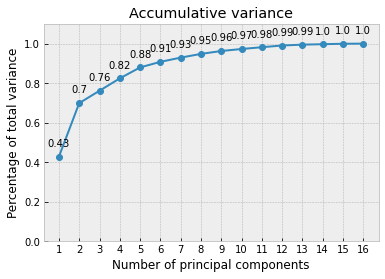

In [14]:
prop_varianza_acum = pca_model.explained_variance_ratio_.cumsum()
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(6, 4))
ax.plot(
    np.arange(len(X_train.columns)) + 1,
    prop_varianza_acum,
    marker = 'o'
)

for x, y in zip(np.arange(len(X_train.columns)) + 1, prop_varianza_acum):
    label = round(y, 2)
    ax.annotate(
        label,
        (x,y),
        textcoords="offset points",
        xytext=(0,10),
        ha='center'
    )
    
ax.set_ylim(0, 1.1)
ax.set_xticks(np.arange(pca_model.n_components_) + 1)
ax.set_title('Accumulative variance')
ax.set_xlabel('Number of principal components')
ax.set_ylabel('Percentage of total variance');

In [15]:
from sklearn.model_selection import GridSearchCV
param_grid = {'pca__n_components': np.arange(1,16).tolist()}

grid = GridSearchCV(
        estimator  = pca_pipe,
        param_grid = param_grid,
    return_train_score=True)

grid.fit(X_train,y_train_clip)

results = pd.DataFrame(grid.cv_results_)
results.filter(regex = '(param.*|mean_t|std_t)') \
    .drop(columns = 'params') \
    .sort_values('mean_test_score', ascending = False)

,param_pca__n_components,mean_test_score,std_test_score,mean_train_score,std_train_score
14,15,-12.385091,0.396525,-12.302872,0.054797
13,14,-12.553463,0.411339,-12.467694,0.049690
12,13,-12.587020,0.411889,-12.505254,0.046412
11,12,-12.760351,0.391007,-12.674947,0.052935
10,11,-13.175268,0.394305,-13.083807,0.057799
9,10,-13.382915,0.381706,-13.298388,0.062721
8,9,-13.542608,0.371523,-13.460907,0.066652
7,8,-13.829702,0.369723,-13.748490,0.065189
6,7,-14.164154,0.387044,-14.078480,0.068914
5,6,-14.450890,0.374876,-14.367876,0.066129


<ipython-input-17-37c4348741ed>:5: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  ax.fill_between(results.param_pca__n_components.astype(np.float),


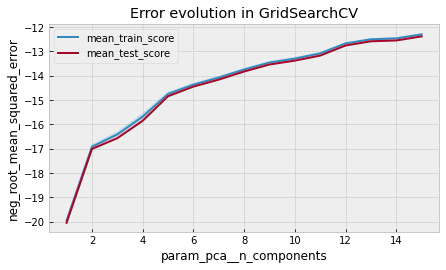

In [17]:
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(7, 3.84), sharey=True)

results.plot('param_pca__n_components', 'mean_train_score', ax=ax)
results.plot('param_pca__n_components', 'mean_test_score', ax=ax)
ax.fill_between(results.param_pca__n_components.astype(np.float),
                results['mean_train_score'] + results['std_train_score'],
                results['mean_train_score'] - results['std_train_score'],
                alpha=0.2)

ax.legend()
ax.set_title('Error evolution in GridSearchCV')
ax.set_ylabel('neg_root_mean_squared_error');

In [18]:
print("Best number of components found: ",grid.best_params_ )

Best number of components found:  {'pca__n_components': 15}


### Train the PCA

In [57]:
pipe_modelado = make_pipeline(StandardScaler(), PCA(n_components=list(grid.best_params_.values())[0]), LinearRegression())
pipe_modelado.fit(X=X_train, y=y_train_clip)

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('pca', PCA(n_components=15)),
                ('linearregression', LinearRegression())])

Baseline Model for PCA

In [58]:
preds_train_clip = pipe_modelado.predict(X_train)
print("TRAIN SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_train_clip,preds_train_clip), "\n",
      "MSE: ", mean_squared_error(y_train_clip, preds_train_clip), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_train_clip, preds_train_clip)), "\n",
      "R2 score: ", r2_score(y_train_clip, preds_train_clip))
lr_PCA_clip_TR_score = r2_score(y_train_clip, preds_train_clip)

TRAIN SCORES - - - -  
 MAE:  14.254463285944723 
 MSE:  427.85014030911975 
 RMSE:  20.684538677696434 
 R2 score:  0.7407748851743972


In [59]:
preds_test = pipe_modelado.predict(X_test)
print("TEST SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_test,preds_test), "\n",
      "MSE: ", mean_squared_error(y_test, preds_test), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_test, preds_test)), "\n",
      "R2 score: ", r2_score(y_test, preds_test))
lr_PCA_clip_TS_score = r2_score(y_test, preds_test)

TEST SCORES - - - -  
 MAE:  15.307524879902125 
 MSE:  523.2837291621104 
 RMSE:  22.875395715967635 
 R2 score:  0.6946285819015443


### RF + PCA

In [60]:
regr = RandomForestRegressor()
rf_random = RandomizedSearchCV(estimator=regr, param_distributions=random_grid, random_state=42)
rf_random.fit(X_train, y_train_clip)

n_estimators = list(rf_random.best_params_.values())[0]
max_depth = list(rf_random.best_params_.values())[1]
min_samples_leaf = list(rf_random.best_params_.values())[2]

pipe_modelado = make_pipeline(StandardScaler(), PCA(n_components=list(grid.best_params_.values())[0]), RandomForestRegressor(n_estimators=n_estimators, max_depth=max_depth, min_samples_leaf=min_samples_leaf))
pipe_modelado.fit(X=X_train, y=y_train_clip)

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('pca', PCA(n_components=15)),
                ('randomforestregressor',
                 RandomForestRegressor(max_depth=9, min_samples_leaf=10,
                                       n_estimators=64))])

In [61]:
preds_train_clip = pipe_modelado.predict(X_train)
print("TRAIN SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_train_clip,preds_train_clip), "\n",
      "MSE: ", mean_squared_error(y_train_clip, preds_train_clip), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_train_clip, preds_train_clip)), "\n",
      "R2 score: ", r2_score(y_train_clip, preds_train_clip))
rf_PCA_clip_TR_score = r2_score(y_train_clip, preds_train_clip)

TRAIN SCORES - - - -  
 MAE:  5.768020487236207 
 MSE:  221.38012147528096 
 RMSE:  14.878848123268178 
 R2 score:  0.8658705887812177


In [62]:
preds_test = pipe_modelado.predict(X_test)
print("TEST SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_test,preds_test), "\n",
      "MSE: ", mean_squared_error(y_test, preds_test), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_test, preds_test)), "\n",
      "R2 score: ", r2_score(y_test, preds_test))
rf_PCA_clip_TS_score = r2_score(y_test, preds_test)

TEST SCORES - - - -  
 MAE:  12.181071266011656 
 MSE:  485.4962843884945 
 RMSE:  22.033980221205937 
 R2 score:  0.716680109502666


### SVR + PCA

In [63]:
pipe_modelado = make_pipeline(StandardScaler(), PCA(n_components=list(grid.best_params_.values())[0]), SVR(epsilon=0.2))
pipe_modelado.fit(X=X_train, y=y_train_clip)

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('pca', PCA(n_components=15)), ('svr', SVR(epsilon=0.2))])

In [64]:
preds_train_clip = pipe_modelado.predict(X_train)
print("TRAIN SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_train_clip,preds_train_clip), "\n",
      "MSE: ", mean_squared_error(y_train_clip, preds_train_clip), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_train_clip, preds_train_clip)), "\n",
      "R2 score: ", r2_score(y_train_clip, preds_train_clip))
svr_PCA_clip_TR_score = r2_score(y_train_clip, preds_train_clip)

TRAIN SCORES - - - -  
 MAE:  5.197063848197132 
 MSE:  288.8499266363196 
 RMSE:  16.995585504369057 
 R2 score:  0.8249920980613246


In [65]:
preds_test = pipe_modelado.predict(X_test)
print("TEST SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_test,preds_test), "\n",
      "MSE: ", mean_squared_error(y_test, preds_test), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_test, preds_test)), "\n",
      "R2 score: ", r2_score(y_test, preds_test))
svr_PCA_clip_TS_score = r2_score(y_test, preds_test)

TEST SCORES - - - -  
 MAE:  11.505121324623921 
 MSE:  513.7593448743 
 RMSE:  22.66626005485466 
 R2 score:  0.7001867037662167


Best metric achieved is by Random Forest, with 0.716 of test score.
Featured with:
- max_depth=9 
- min_samples_leaf=10
- n_estimators=64

Still lower compared to maximum score reached so far

### Linear Regression + PCA + RUL clipped Variation

Let's apply a RUL variation to check if previously found best clip for RUL changes when applying PCA

In [66]:
clips = np.arange(100,155,5).tolist()
train_scores = []
test_scores = []

for clip in clips:

    y_train_clip = df_train_3["RUL"].clip(upper=clip)
    pipe_model = make_pipeline(StandardScaler(), PCA(n_components=list(grid.best_params_.values())[0]), LinearRegression())
    pipe_model.fit(X=X_train, y=y_train_clip)

    preds_train = pipe_model.predict(X_train)
    r2_tr = r2_score(y_train_clip, preds_train)
    train_scores.append(r2_tr)
    print(" TRAIN SCORE WITH {} upper clipped RUL: ".format(clip), r2_score(y_train_clip, preds_train))
    
    preds_test = pipe_model.predict(X_test)
    r2_ts = r2_score(y_test, preds_test)
    test_scores.append(r2_ts)
    print(" TEST SCORE WITH {} upper clipped RUL: ".format(clip), r2_score(y_test, preds_test))

 TRAIN SCORE WITH 100 upper clipped RUL:  0.7398672365035086
 TEST SCORE WITH 100 upper clipped RUL:  0.6665813723981353
 TRAIN SCORE WITH 105 upper clipped RUL:  0.7417523783649529
 TEST SCORE WITH 105 upper clipped RUL:  0.6903414580173344
 TRAIN SCORE WITH 110 upper clipped RUL:  0.7426412535552772
 TEST SCORE WITH 110 upper clipped RUL:  0.7041552971233133
 TRAIN SCORE WITH 115 upper clipped RUL:  0.7427306632687565
 TEST SCORE WITH 115 upper clipped RUL:  0.7088956861632699
 TRAIN SCORE WITH 120 upper clipped RUL:  0.7420363093594542
 TEST SCORE WITH 120 upper clipped RUL:  0.7054423194522537
 TRAIN SCORE WITH 125 upper clipped RUL:  0.7407748851743972
 TEST SCORE WITH 125 upper clipped RUL:  0.6946285819015443
 TRAIN SCORE WITH 130 upper clipped RUL:  0.7390559425575275
 TEST SCORE WITH 130 upper clipped RUL:  0.6772044460403688
 TRAIN SCORE WITH 135 upper clipped RUL:  0.7369479604734387
 TEST SCORE WITH 135 upper clipped RUL:  0.6539838649752685
 TRAIN SCORE WITH 140 upper clip

Train Score from max Test Score:  0.7427306632687565 
 Max Test Score:  0.7088956861632699 
 Achieved with 115 upper clipped RUL


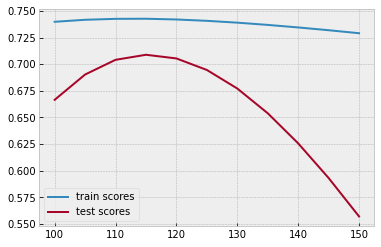

In [67]:
plt.plot(clips,train_scores,label="train scores")
plt.plot(clips, test_scores, label="test scores")
plt.legend()

mx_test = max(test_scores)
mx_idx = test_scores.index(mx_test)
train_mx_test = train_scores[mx_idx]
clip_mx = clips[mx_idx]
print("Train Score from max Test Score: ", train_mx_test, "\n",
      "Max Test Score: ", mx_test, "\n",
     "Achieved with {} upper clipped RUL".format(clip_mx))
lr_varclip_PCA_TR_score = train_mx_test
lr_varclip_PCA_TS_score = mx_test

### Random Forest Regressor + PCA + RUL clipped Variation

In [81]:
clips = np.arange(100,155,5).tolist()
train_scores = []
test_scores = []


for clip in clips:

    y_train_clip = df_train_3["RUL"].clip(upper=clip)
    regr = RandomForestRegressor()
    rf_random = RandomizedSearchCV(estimator=regr, param_distributions=random_grid, random_state=42)
    rf_random.fit(X_train, y_train_clip)
    n_estimators = 10
    max_depth = 9
    min_samples_leaf = 64
    
    pipe_model = make_pipeline(StandardScaler(), PCA(n_components=list(grid.best_params_.values())[0]), RandomForestRegressor(n_estimators=n_estimators, max_depth=max_depth, min_samples_leaf=min_samples_leaf))
    pipe_model.fit(X=X_train, y=y_train_clip)
    
    preds_train = pipe_model.predict(X_train)
    r2_tr = r2_score(y_train_clip, preds_train)
    train_scores.append(r2_tr)
    print(" TRAIN SCORE WITH {} upper clipped RUL: ".format(clip), r2_score(y_train_clip, preds_train))
    
    preds_test = pipe_model.predict(X_test)
    r2_ts = r2_score(y_test, preds_test)
    test_scores.append(r2_ts)
    print(" TEST SCORE WITH {} upper clipped RUL: ".format(clip), r2_score(y_test, preds_test))

 TRAIN SCORE WITH 100 upper clipped RUL:  0.8733191651582755
 TEST SCORE WITH 100 upper clipped RUL:  0.703603140928003
 TRAIN SCORE WITH 105 upper clipped RUL:  0.8686278892772212
 TEST SCORE WITH 105 upper clipped RUL:  0.7261347330426365
 TRAIN SCORE WITH 110 upper clipped RUL:  0.862488824140664
 TEST SCORE WITH 110 upper clipped RUL:  0.7318207941025461
 TRAIN SCORE WITH 115 upper clipped RUL:  0.8572555039532527
 TEST SCORE WITH 115 upper clipped RUL:  0.7272493445752446
 TRAIN SCORE WITH 120 upper clipped RUL:  0.8522453145151686
 TEST SCORE WITH 120 upper clipped RUL:  0.726911578488431
 TRAIN SCORE WITH 125 upper clipped RUL:  0.8463355534876047
 TEST SCORE WITH 125 upper clipped RUL:  0.7179719450856707
 TRAIN SCORE WITH 130 upper clipped RUL:  0.8405359473300389
 TEST SCORE WITH 130 upper clipped RUL:  0.6864464647933828
 TRAIN SCORE WITH 135 upper clipped RUL:  0.8334854306765936
 TEST SCORE WITH 135 upper clipped RUL:  0.6617974968752204
 TRAIN SCORE WITH 140 upper clipped

Train Score from max Test Score:  0.862488824140664 
 Max Test Score:  0.7318207941025461 
 Achieved with 110 upper clipped RUL


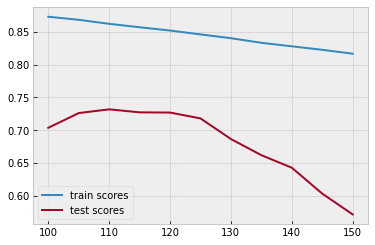

In [82]:
plt.plot(clips,train_scores,label="train scores")
plt.plot(clips, test_scores, label="test scores")
plt.legend()

mx_test = max(test_scores)
mx_idx = test_scores.index(mx_test)
train_mx_test = train_scores[mx_idx]
clip_mx = clips[mx_idx]
print("Train Score from max Test Score: ", train_mx_test, "\n",
      "Max Test Score: ", mx_test, "\n",
     "Achieved with {} upper clipped RUL".format(clip_mx))
rf_varclip_PCA_TR_score = train_mx_test
rf_varclip_PCA_TS_score = mx_test

### SVR + PCA + RUL clipped Variation

In [84]:
clips = np.arange(100,155,5).tolist()
train_scores = []
test_scores = []

for clip in clips:

    y_train_clip = df_train_3["RUL"].clip(upper=clip)
    pipe_model = make_pipeline(StandardScaler(),PCA(n_components=list(grid.best_params_.values())[0]), SVR(epsilon=0.2))
    pipe_model.fit(X=X_train, y=y_train_clip)

    preds_train = pipe_model.predict(X_train)
    r2_tr = r2_score(y_train_clip, preds_train)
    train_scores.append(r2_tr)
    print(" TRAIN SCORE WITH {} upper clipped RUL: ".format(clip), r2_score(y_train_clip, preds_train))
    
    preds_test = pipe_model.predict(X_test)
    r2_ts = r2_score(y_test, preds_test)
    test_scores.append(r2_ts)
    print(" TEST SCORE WITH {} upper clipped RUL: ".format(clip), r2_score(y_test, preds_test))

 TRAIN SCORE WITH 100 upper clipped RUL:  0.8556636558339381
 TEST SCORE WITH 100 upper clipped RUL:  0.7104488417035899
 TRAIN SCORE WITH 105 upper clipped RUL:  0.8496368358508636
 TEST SCORE WITH 105 upper clipped RUL:  0.7276449766911852
 TRAIN SCORE WITH 110 upper clipped RUL:  0.8437356949635394
 TEST SCORE WITH 110 upper clipped RUL:  0.7346514897213334
 TRAIN SCORE WITH 115 upper clipped RUL:  0.8374687908097013
 TEST SCORE WITH 115 upper clipped RUL:  0.731117281055671
 TRAIN SCORE WITH 120 upper clipped RUL:  0.8312034885996411
 TEST SCORE WITH 120 upper clipped RUL:  0.7190219593954659
 TRAIN SCORE WITH 125 upper clipped RUL:  0.8249920980613246
 TEST SCORE WITH 125 upper clipped RUL:  0.7001867037662167
 TRAIN SCORE WITH 130 upper clipped RUL:  0.8187234252852686
 TEST SCORE WITH 130 upper clipped RUL:  0.6758931669996662
 TRAIN SCORE WITH 135 upper clipped RUL:  0.8123444315493434
 TEST SCORE WITH 135 upper clipped RUL:  0.6459309760555307
 TRAIN SCORE WITH 140 upper clipp

Train Score from max Test Score:  0.8437356949635394 
 Max Test Score:  0.7346514897213334 
 Achieved with 110 upper clipped RUL


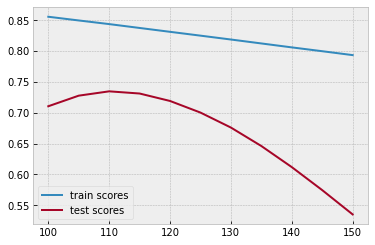

In [85]:
plt.plot(clips,train_scores,label="train scores")
plt.plot(clips, test_scores, label="test scores")
plt.legend()

mx_test = max(test_scores)
mx_idx = test_scores.index(mx_test)
train_mx_test = train_scores[mx_idx]
clip_mx = clips[mx_idx]
print("Train Score from max Test Score: ", train_mx_test, "\n",
      "Max Test Score: ", mx_test, "\n",
     "Achieved with {} upper clipped RUL".format(clip_mx))
svr_varclip_PCA_TR_score = train_mx_test
svr_varclip_PCA_TS_score = mx_test

Better results have been reached when applying to PCA the RUL variation, the maximum is achieved by SVR with 110 clip limit, with 0.734 test score.
However, the top features together with RUL variation remains as top score in this analysis.
Best score so far is from Random Forest with 11 top features and 115 clip RUL, with 0.753

# Addition of Lagged Variables

As performed in previous studies, the process wil change to a strategy of augmenting the dimensionality. Addition of lagged variables has demonstrated in the past to provide positive results. Let's check their impact on this dataset.

In [35]:
df_train_3.columns[2:len(df_train_3.columns)-1]

df_train_3_lagg = df_train_3.copy()
sensor_cols = df_train_3.columns[2:len(df_train_3.columns)-1]
lag_cols = []
for col in sensor_cols:
    col = col + "_lag1"
    lag_cols.append(col)
df_train_3_lagg[lag_cols] = df_train_3.groupby("ID")[sensor_cols].shift(1)
df_train_3_lagg.dropna(inplace=True)
df_train_3_lagg

,ID,Cycle,operational_setting_1,operational_setting_2,sensor_measurement_2,sensor_measurement_3,sensor_measurement_4,sensor_measurement_7,sensor_measurement_8,sensor_measurement_9,sensor_measurement_11,sensor_measurement_12,sensor_measurement_13,sensor_measurement_14,sensor_measurement_15,sensor_measurement_17,sensor_measurement_20,sensor_measurement_21,RUL,operational_setting_1_lag1,operational_setting_2_lag1,sensor_measurement_2_lag1,sensor_measurement_3_lag1,sensor_measurement_4_lag1,sensor_measurement_7_lag1,sensor_measurement_8_lag1,sensor_measurement_9_lag1,sensor_measurement_11_lag1,sensor_measurement_12_lag1,sensor_measurement_13_lag1,sensor_measurement_14_lag1,sensor_measurement_15_lag1,sensor_measurement_17_lag1,sensor_measurement_20_lag1,sensor_measurement_21_lag1
1,1,2,0.0008,-0.0003,642.50,1584.69,1396.89,554.55,2388.00,9061.78,47.23,522.42,2388.03,8152.85,8.4403,392,38.99,23.4491,257,-0.0005,0.0004,642.36,1583.23,1396.84,553.97,2387.96,9062.17,47.30,522.31,2388.01,8145.32,8.4246,391.0,39.11,23.3537
2,1,3,-0.0014,-0.0002,642.18,1582.35,1405.61,554.43,2388.03,9070.23,47.22,522.03,2388.00,8150.17,8.3901,391,38.85,23.3669,256,0.0008,-0.0003,642.50,1584.69,1396.89,554.55,2388.00,9061.78,47.23,522.42,2388.03,8152.85,8.4403,392.0,38.99,23.4491
3,1,4,-0.0020,0.0001,642.92,1585.61,1392.27,555.21,2388.00,9064.57,47.24,522.49,2388.08,8146.56,8.3878,392,38.96,23.2951,255,-0.0014,-0.0002,642.18,1582.35,1405.61,554.43,2388.03,9070.23,47.22,522.03,2388.00,8150.17,8.3901,391.0,38.85,23.3669
4,1,5,0.0016,0.0000,641.68,1588.63,1397.65,554.74,2388.04,9076.14,47.15,522.58,2388.03,8147.80,8.3869,392,39.14,23.4583,254,-0.0020,0.0001,642.92,1585.61,1392.27,555.21,2388.00,9064.57,47.24,522.49,2388.08,8146.56,8.3878,392.0,38.96,23.2951
5,1,6,0.0011,-0.0005,642.24,1584.09,1400.01,554.75,2388.00,9074.98,47.07,522.42,2388.02,8144.92,8.4152,393,38.92,23.4281,253,0.0016,0.0000,641.68,1588.63,1397.65,554.74,2388.04,9076.14,47.15,522.58,2388.03,8147.80,8.3869,392.0,39.14,23.4583
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24715,100,148,-0.0016,-0.0003,643.78,1596.01,1424.11,551.86,2388.25,9070.82,48.27,519.66,2388.30,8138.08,8.5036,394,38.44,22.9631,4,0.0004,0.0001,643.62,1601.51,1424.82,551.62,2388.27,9057.21,48.11,519.82,2388.24,8139.61,8.5379,395.0,38.59,23.0528
24716,100,149,0.0034,-0.0003,643.29,1596.38,1429.14,551.86,2388.23,9064.60,48.13,519.91,2388.28,8144.36,8.5174,395,38.50,22.9746,3,-0.0016,-0.0003,643.78,1596.01,1424.11,551.86,2388.25,9070.82,48.27,519.66,2388.30,8138.08,8.5036,394.0,38.44,22.9631
24717,100,150,-0.0016,0.0004,643.84,1604.53,1431.41,551.30,2388.25,9063.45,48.18,519.44,2388.24,8135.95,8.5223,396,38.39,23.0682,2,0.0034,-0.0003,643.29,1596.38,1429.14,551.86,2388.23,9064.60,48.13,519.91,2388.28,8144.36,8.5174,395.0,38.50,22.9746
24718,100,151,-0.0023,0.0004,643.94,1597.56,1426.57,550.69,2388.26,9062.22,48.05,520.01,2388.26,8141.24,8.5148,395,38.31,23.0753,1,-0.0016,0.0004,643.84,1604.53,1431.41,551.30,2388.25,9063.45,48.18,519.44,2388.24,8135.95,8.5223,396.0,38.39,23.0682


In [36]:
df_test_3_lagg = df_test_3.copy()
sensor_cols = df_test_3.columns[2:len(df_train_3.columns)]
lag_cols = []
for col in sensor_cols:
    col = col + "_lag1"
    lag_cols.append(col)
df_test_3_lagg[lag_cols] = df_test_3.groupby("ID")[sensor_cols].shift(1)
df_test_3_lagg.dropna(inplace=True)
df_test_3_lagg

,ID,Cycle,operational_setting_1,operational_setting_2,sensor_measurement_2,sensor_measurement_3,sensor_measurement_4,sensor_measurement_7,sensor_measurement_8,sensor_measurement_9,sensor_measurement_11,sensor_measurement_12,sensor_measurement_13,sensor_measurement_14,sensor_measurement_15,sensor_measurement_17,sensor_measurement_20,sensor_measurement_21,operational_setting_1_lag1,operational_setting_2_lag1,sensor_measurement_2_lag1,sensor_measurement_3_lag1,sensor_measurement_4_lag1,sensor_measurement_7_lag1,sensor_measurement_8_lag1,sensor_measurement_9_lag1,sensor_measurement_11_lag1,sensor_measurement_12_lag1,sensor_measurement_13_lag1,sensor_measurement_14_lag1,sensor_measurement_15_lag1,sensor_measurement_17_lag1,sensor_measurement_20_lag1,sensor_measurement_21_lag1
1,1,2,0.0006,-0.0002,642.02,1584.86,1398.90,554.10,2387.94,9046.53,47.08,521.85,2388.01,8137.44,8.4062,391,39.04,23.4807,-0.0017,-0.0004,641.94,1581.93,1396.93,554.56,2387.93,9048.65,47.09,521.89,2387.94,8133.48,8.3760,391.0,39.07,23.4468
2,1,3,0.0014,-0.0003,641.68,1581.78,1391.92,554.41,2387.97,9054.92,47.15,522.10,2387.94,8138.25,8.3553,391,39.10,23.4244,0.0006,-0.0002,642.02,1584.86,1398.90,554.10,2387.94,9046.53,47.08,521.85,2388.01,8137.44,8.4062,391.0,39.04,23.4807
3,1,4,0.0027,0.0001,642.20,1584.53,1395.34,554.58,2387.94,9055.04,47.26,522.45,2387.96,8137.07,8.3709,392,38.97,23.4782,0.0014,-0.0003,641.68,1581.78,1391.92,554.41,2387.97,9054.92,47.15,522.10,2387.94,8138.25,8.3553,391.0,39.10,23.4244
4,1,5,-0.0001,0.0001,642.46,1589.03,1395.86,554.16,2388.01,9048.59,46.94,521.91,2387.97,8134.20,8.4146,391,39.09,23.3950,0.0027,0.0001,642.20,1584.53,1395.34,554.58,2387.94,9055.04,47.26,522.45,2387.96,8137.07,8.3709,392.0,38.97,23.4782
5,1,6,-0.0034,0.0001,641.74,1582.87,1397.04,554.48,2388.01,9054.91,47.14,522.59,2388.05,8134.28,8.3647,390,38.98,23.4050,-0.0001,0.0001,642.46,1589.03,1395.86,554.16,2388.01,9048.59,46.94,521.91,2387.97,8134.20,8.4146,391.0,39.09,23.3950
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16591,100,243,0.0011,-0.0003,643.04,1594.99,1411.28,561.21,2388.24,9088.31,47.61,529.23,2388.24,8162.24,8.2939,395,39.40,23.4949,-0.0033,-0.0004,642.58,1593.85,1415.61,561.09,2388.21,9083.89,47.55,528.41,2388.19,8163.57,8.2941,394.0,39.38,23.6768
16592,100,244,-0.0024,0.0002,642.47,1591.27,1417.64,561.02,2388.29,9085.35,47.75,529.27,2388.26,8163.24,8.3247,394,39.42,23.6011,0.0011,-0.0003,643.04,1594.99,1411.28,561.21,2388.24,9088.31,47.61,529.23,2388.24,8162.24,8.2939,395.0,39.40,23.4949
16593,100,245,-0.0053,0.0002,642.70,1593.81,1412.70,561.16,2388.23,9084.29,47.60,529.48,2388.28,8162.12,8.3264,394,39.43,23.5482,-0.0024,0.0002,642.47,1591.27,1417.64,561.02,2388.29,9085.35,47.75,529.27,2388.26,8163.24,8.3247,394.0,39.42,23.6011
16594,100,246,-0.0006,0.0001,642.19,1595.63,1406.58,562.66,2388.24,9092.52,47.69,529.39,2388.33,8164.20,8.2908,395,39.40,23.6687,-0.0053,0.0002,642.70,1593.81,1412.70,561.16,2388.23,9084.29,47.60,529.48,2388.28,8162.12,8.3264,394.0,39.43,23.5482


In [37]:
X_trainL = df_train_3_lagg.drop(columns=["Cycle","RUL"], axis=1)
y_trainL_clip = df_train_3_lagg["RUL"].clip(upper=125)

df_test_3_redL = df_test_3_lagg.groupby("ID").last().reset_index()
X_testL = df_test_3_redL.drop(columns=["Cycle"], axis=1)
y_testL = df_RUL_3

### Linear Regression + Lagged Variables + RUL clipped

In [75]:
lr = LinearRegression()
lr.fit(X_trainL, y_trainL_clip)

LinearRegression()

In [76]:
preds_y_train = lr.predict(X_trainL)
print("TRAIN SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_trainL_clip,preds_y_train), "\n",
      "MSE: ", mean_squared_error(y_trainL_clip, preds_y_train), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_trainL_clip, preds_y_train)), "\n",
      "R2 score: ", r2_score(y_trainL_clip, preds_y_train))
lr_lagg_clip_TR_score = r2_score(y_trainL_clip, preds_y_train)

TRAIN SCORES - - - -  
 MAE:  13.485765698591422 
 MSE:  402.6900385673843 
 RMSE:  20.067138275483735 
 R2 score:  0.7563974317077706


In [77]:
preds_y_test = lr.predict(X_testL)
print("TEST SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_testL, preds_y_test), "\n",
      "MSE: ", mean_squared_error(y_testL, preds_y_test), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_testL, preds_y_test)), "\n",
      "R2 score: ", r2_score(y_testL, preds_y_test))
lr_lagg_clip_TS_score = r2_score(y_testL, preds_y_test)

TEST SCORES - - - -  
 MAE:  14.784431094583852 
 MSE:  508.27932837995627 
 RMSE:  22.54505108399527 
 R2 score:  0.7033846637157077


### RF + Lagged Variables + RUL clip

In [86]:
n_estimators = [int(x) for x in np.linspace(start = 70, stop = 100, num = 10)]

max_depth = [int(x) for x in np.linspace(10, 20, num = 5)]
min_samples_leaf = [int(x) for x in np.linspace(start = 10, stop = 20, num = 5)]

random_grid = {'n_estimators': n_estimators,
               'max_depth': max_depth,
              "min_samples_leaf":min_samples_leaf}
print(random_grid)

regr = RandomForestRegressor()
rf_random = RandomizedSearchCV(estimator=regr, param_distributions=random_grid, random_state=42)
rf_random.fit(X_trainL, y_trainL_clip)

n_estimators = list(rf_random.best_params_.values())[0]
max_depth = list(rf_random.best_params_.values())[1]
min_samples_leaf = list(rf_random.best_params_.values())[2]

hyper_regr = RandomForestRegressor(n_estimators=n_estimators, max_depth=max_depth, min_samples_leaf=min_samples_leaf)
hyper_regr.fit(X_trainL, y_trainL_clip)

{'n_estimators': [70, 73, 76, 80, 83, 86, 90, 93, 96, 100], 'max_depth': [10, 12, 15, 17, 20], 'min_samples_leaf': [10, 12, 15, 17, 20]}


RandomForestRegressor(max_depth=20, min_samples_leaf=17, n_estimators=93)

In [87]:
preds_y_train = hyper_regr.predict(X_trainL)
print("TRAIN SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_trainL_clip,preds_y_train), "\n",
      "MSE: ", mean_squared_error(y_trainL_clip, preds_y_train), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_trainL_clip, preds_y_train)), "\n",
      "R2 score: ", r2_score(y_trainL_clip, preds_y_train))
lr_lagg_clip_TR_score = r2_score(y_trainL_clip, preds_y_train)

TRAIN SCORES - - - -  
 MAE:  4.699830428932827 
 MSE:  137.71215709658156 
 RMSE:  11.73508232167894 
 R2 score:  0.9166926619959669


In [88]:
preds_y_test = hyper_regr.predict(X_testL)
print("TEST SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_testL, preds_y_test), "\n",
      "MSE: ", mean_squared_error(y_testL, preds_y_test), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_testL, preds_y_test)), "\n",
      "R2 score: ", r2_score(y_testL, preds_y_test))
lr_lagg_clip_TS_score = r2_score(y_testL, preds_y_test)

TEST SCORES - - - -  
 MAE:  12.529298856935306 
 MSE:  464.8377129195627 
 RMSE:  21.560095382895753 
 R2 score:  0.7287357820064859


### SVR + Lagged Variables + RUL clip

In [91]:
svr = make_pipeline(StandardScaler(), SVR(epsilon=0.2))
svr.fit(X_trainL, y_trainL_clip)        

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('svr', SVR(epsilon=0.2))])

In [92]:
preds_y_train = svr.predict(X_trainL)
print("TRAIN SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_trainL_clip,preds_y_train), "\n",
      "MSE: ", mean_squared_error(y_trainL_clip, preds_y_train), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_trainL_clip, preds_y_train)), "\n",
      "R2 score: ", r2_score(y_trainL_clip, preds_y_train))
lr_lagg_clip_TR_score = r2_score(y_trainL_clip, preds_y_train)

TRAIN SCORES - - - -  
 MAE:  5.087233365238962 
 MSE:  265.14579750741234 
 RMSE:  16.283298115167344 
 R2 score:  0.839603190894704


In [93]:
preds_y_test = svr.predict(X_testL)
print("TEST SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_testL, preds_y_test), "\n",
      "MSE: ", mean_squared_error(y_testL, preds_y_test), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_testL, preds_y_test)), "\n",
      "R2 score: ", r2_score(y_testL, preds_y_test))
lr_lagg_clip_TS_score = r2_score(y_testL, preds_y_test)

TEST SCORES - - - -  
 MAE:  11.784173742647006 
 MSE:  524.014485759725 
 RMSE:  22.89136268900838 
 R2 score:  0.6942021360442353


What's found here is that test score has not increased as much as expected, but train scores are quite high now, and risks to overfit. Let's try to reduce this over dimensionality by applying the same strategy that provided good results previously (selecting top features based on slope value) but applied this time not only to dataset initial features but also to lagged ones.

,columns,slope
4,sensor_measurement_4,[[0.10722088428902288]]
21,sensor_measurement_4_lag1,[[0.1055944097723122]]
3,sensor_measurement_3,[[0.05435720102899535]]
20,sensor_measurement_3_lag1,[[0.053966653029181216]]
24,sensor_measurement_9_lag1,[[0.026109686609188672]]
7,sensor_measurement_9,[[0.025758730407178205]]
13,sensor_measurement_17,[[0.016649028774628264]]
30,sensor_measurement_17_lag1,[[0.0163656811923937]]
5,sensor_measurement_7,[[0.010478214553863824]]
22,sensor_measurement_7_lag1,[[0.01032833381489613]]


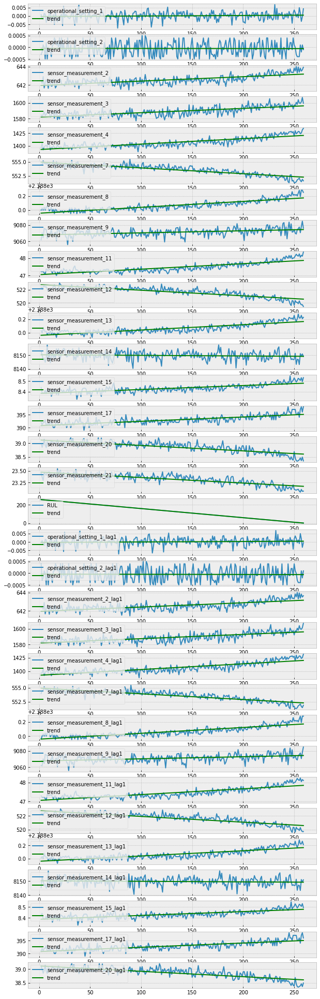

In [38]:
df_3_L = df_train_3_lagg[df_train_3_lagg["ID"]==1]
x = df_3_L["Cycle"].values.reshape(-1,1)

cols = df_3_L.columns[2:-1]
fig, axes = plt.subplots(len(cols), 1, figsize=(10,35))
slopes = []
for col, ax in zip(cols, axes):
    linear = LinearRegression()
    y = df_3_L[col].values.reshape(-1,1)
    linear.fit(x,y)
    preds = linear.predict(x)
    ax.plot(x,y, label=col)
    ax.plot(x,preds,"g",label='trend')
    ax.legend(loc=2)
    slope = linear.coef_
    slopes.append(slope)
slopes_df_L = pd.DataFrame({"columns": cols, "slope":slopes})
slopes_df_L["slope"] = slopes_df_L["slope"].apply(lambda x: abs(x))
slopes_df_L = slopes_df_L.sort_values("slope", ascending=False)[1:]
slopes_df_L

## LR + Lagg variables + combination loop top features & RUL clipped

In [79]:
columns_L = slopes_df_L.sort_values("slope", ascending=False)["columns"].values.tolist()
column=[]

clips = np.arange(100,185,5).tolist()
best_test_score = []
best_train_score = []
lens_columns = []
top_clips = []
for col in columns_L:
    
    train_score = []
    test_score = []
    
    
    column.append(col) 
    
    dfL = df_train_3_lagg[["ID","Cycle"]+column]
    X_train_ = dfL.drop(columns=["ID","Cycle"], axis=1)    
    df_test = df_test_3_lagg[["ID", "Cycle"]+column]
    df_test_red = df_test.groupby("ID").last().reset_index()
    X_test_ = df_test_red.drop(columns=["ID","Cycle"], axis=1)
    y_test = df_RUL_3
    
    print(" Scores with {} top features: ".format(len(column)))
    
    for clip in clips:
        
        y_train = df_train_3_lagg["RUL"].clip(upper=clip)

        lr = LinearRegression()
        lr.fit(X_train_, y_train)

        preds_train = lr.predict(X_train_)
        r2_tr = r2_score(y_train, preds_train)
        train_scores.append(r2_tr)
          
        preds_test = lr.predict(X_test_)
        r2_ts = r2_score(y_test, preds_test)
        test_scores.append(r2_ts)
        
        test_score.append(r2_ts)
        train_score.append(r2_tr)
              
    mx_test = max(test_score)
    mx_idx = test_score.index(mx_test)
    train_mx_test = train_score[mx_idx]
    top_clip = clips[mx_idx]
    print(" best metrics with {} top features: ".format(len(column)), "\n",
                                                       "train:",train_mx_test,"test",mx_test,
                                                       "with clip:", top_clip)
    best_test_score.append(mx_test)
    best_train_score.append(train_mx_test)
    lens_columns.append(len(column))

mx_best_test = max(best_test_score)
mx_idx_best = best_test_score.index(mx_best_test)
train_mx_best = best_train_score[mx_idx_best]
top_column = lens_columns[mx_idx_best]

print("\n"*3,
      "BEST METRICS for combination of top features and upper RUL clip: ",
     "\n", "Features number:", top_column,"\n",
     "Best Train Score: ", train_mx_best, " Best Test Score:", mx_best_test)

 Scores with 1 top features: 
 best metrics with 1 top features:  
 train: 0.5942609065941589 test 0.5232042182053536 with clip: 110
 Scores with 2 top features: 
 best metrics with 2 top features:  
 train: 0.6475262069522846 test 0.5425648197346615 with clip: 115
 Scores with 3 top features: 
 best metrics with 3 top features:  
 train: 0.6668516254197061 test 0.55631045192909 with clip: 115
 Scores with 4 top features: 
 best metrics with 4 top features:  
 train: 0.678674507746462 test 0.5700717973335945 with clip: 115
 Scores with 5 top features: 
 best metrics with 5 top features:  
 train: 0.7225427985837862 test 0.6509349758236115 with clip: 120
 Scores with 6 top features: 
 best metrics with 6 top features:  
 train: 0.7247532584372873 test 0.6557337539412722 with clip: 120
 Scores with 7 top features: 
 best metrics with 7 top features:  
 train: 0.7292690873680927 test 0.6539858068289217 with clip: 115
 Scores with 8 top features: 
 best metrics with 8 top features:  
 trai

In [60]:
columns_L = slopes_df_L.sort_values("slope", ascending=False)["columns"].values.tolist()
column_init=columns_L[:10]

clips = np.arange(100,135,5).tolist()
best_test_score = []
best_train_score = []
lens_columns = []
top_clips = []
for col in columns_L[11:]:
    
    train_score = []
    test_score = []
    
    
    column_init.append(col) 
    
    dfL = df_train_3_lagg[["ID","Cycle"]+column_init]
    X_train_ = dfL.drop(columns=["ID","Cycle"], axis=1)    
    df_test = df_test_3_lagg[["ID", "Cycle"]+column_init]
    df_test_red = df_test.groupby("ID").last().reset_index()
    X_test_ = df_test_red.drop(columns=["ID","Cycle"], axis=1)
    y_test = df_RUL_3
    
    print(" Scores with {} top features: ".format(len(column_init)))
    
    for clip in clips:
        
        y_train = df_train_3_lagg["RUL"].clip(upper=clip)

        lr = LinearRegression()
        lr.fit(X_train_, y_train)

        preds_train = lr.predict(X_train_)
        r2_tr = r2_score(y_train, preds_train)
        train_scores.append(r2_tr)
          
        preds_test = lr.predict(X_test_)
        r2_ts = r2_score(y_test, preds_test)
        test_scores.append(r2_ts)
        
        test_score.append(r2_ts)
        train_score.append(r2_tr)
              
    mx_test = max(test_score)
    mx_idx = test_score.index(mx_test)
    train_mx_test = train_score[mx_idx]
    top_clip = clips[mx_idx]
    print(" best metrics with {} top features: ".format(len(column_init)), "\n",
                                                       "train:",train_mx_test,"test",mx_test,
                                                       "with clip:", top_clip)
    best_test_score.append(mx_test)
    best_train_score.append(train_mx_test)
    lens_columns.append(len(column_init))

mx_best_test = max(best_test_score)
mx_idx_best = best_test_score.index(mx_best_test)
train_mx_best = best_train_score[mx_idx_best]
top_column = lens_columns[mx_idx_best]

print("\n"*3,
      "BEST METRICS for combination of top features and upper RUL clip: ",
     "\n", "Features number:", top_column,"\n",
     "Best Train Score: ", train_mx_best, " Best Test Score:", mx_best_test)

 Scores with 11 top features: 
 best metrics with 11 top features:  
 train: 0.7343790964526491 test 0.6690771300778071 with clip: 120
 Scores with 12 top features: 
 best metrics with 12 top features:  
 train: 0.7373576596091915 test 0.6815660522328912 with clip: 120
 Scores with 13 top features: 
 best metrics with 13 top features:  
 train: 0.7394191237341029 test 0.6817196533406968 with clip: 120
 Scores with 14 top features: 
 best metrics with 14 top features:  
 train: 0.7394268038139375 test 0.6815343610143287 with clip: 120
 Scores with 15 top features: 
 best metrics with 15 top features:  
 train: 0.7394292821125747 test 0.681473824262641 with clip: 120
 Scores with 16 top features: 
 best metrics with 16 top features:  
 train: 0.7475553689377389 test 0.7017039871691608 with clip: 115
 Scores with 17 top features: 
 best metrics with 17 top features:  
 train: 0.7507883592125617 test 0.7107352091481146 with clip: 120
 Scores with 18 top features: 
 best metrics with 18 top

## Random Forest Regressor + Lagg Variables + combination top features & RUL clipped

In [61]:
columns_L = slopes_df_L.sort_values("slope", ascending=False)["columns"].values.tolist()
column_init=columns_L[:15]

clips = np.arange(100,125,5).tolist()
best_test_score = []
best_train_score = []
lens_columns = []
top_clips = []

n_estimators = 93
max_depth = 20
min_samples_leaf = 17

for col in columns_L[16:]:
    
    train_score = []
    test_score = []
    
    
    column_init.append(col) # the number of columns in the model will be one by one increasing
    
    dfL = df_train_3_lagg[["ID","Cycle"]+column_init]
    X_train_ = dfL.drop(columns=["ID","Cycle"], axis=1)    
    df_test = df_test_3_lagg[["ID", "Cycle"]+column_init]
    df_test_red = df_test.groupby("ID").last().reset_index()
    X_test_ = df_test_red.drop(columns=["ID","Cycle"], axis=1)
    y_test = df_RUL_3
    
    print(" Scores with {} top features: ".format(len(column_init)))
    
    for clip in clips:
        
        y_train = df_train_3_lagg["RUL"].clip(upper=clip)

        hyper_regr = RandomForestRegressor(n_estimators=n_estimators, max_depth=max_depth, min_samples_leaf=min_samples_leaf)
        hyper_regr.fit(X_train_, y_train)
        
        preds_train = hyper_regr.predict(X_train_)
        r2_tr = r2_score(y_train, preds_train)
        train_scores.append(r2_tr)
          
        preds_test = hyper_regr.predict(X_test_)
        r2_ts = r2_score(y_test, preds_test)
        test_scores.append(r2_ts)
        
        test_score.append(r2_ts)
        train_score.append(r2_tr)
              
    mx_test = max(test_score)
    mx_idx = test_score.index(mx_test)
    train_mx_test = train_score[mx_idx]
    top_clip = clips[mx_idx]
    print(" best metrics with {} top features: ".format(len(column_init)), "\n",
                                                       "train:",train_mx_test,"test",mx_test,
                                                       "with clip:", top_clip)
    best_test_score.append(mx_test)
    best_train_score.append(train_mx_test)
    lens_columns.append(len(column_init))

mx_best_test = max(best_test_score)
mx_idx_best = best_test_score.index(mx_best_test)
train_mx_best = best_train_score[mx_idx_best]
top_column = lens_columns[mx_idx_best]

print("\n"*3,
      "BEST METRICS for combination of top features and upper RUL clip: ",
     "\n", "Features number:", top_column,"\n",
     "Best Train Score: ", train_mx_best, " Best Test Score:", mx_best_test)

 Scores with 16 top features: 
 best metrics with 16 top features:  
 train: 0.8958478624902527 test 0.7533440349330014 with clip: 110
 Scores with 17 top features: 
 best metrics with 17 top features:  
 train: 0.8892116568077241 test 0.7610935269862906 with clip: 120
 Scores with 18 top features: 
 best metrics with 18 top features:  
 train: 0.8937916579212718 test 0.7608178714824718 with clip: 115
 Scores with 19 top features: 
 best metrics with 19 top features:  
 train: 0.8898332123315583 test 0.7603021414241308 with clip: 120
 Scores with 20 top features: 
 best metrics with 20 top features:  
 train: 0.8906888880936629 test 0.7646980464121096 with clip: 120
 Scores with 21 top features: 
 best metrics with 21 top features:  
 train: 0.8912263667917548 test 0.7637535315676794 with clip: 120
 Scores with 22 top features: 
 best metrics with 22 top features:  
 train: 0.895524415516702 test 0.7617346809324587 with clip: 115
 Scores with 23 top features: 
 best metrics with 23 top

## SVR + Lagg variables + combination top features & RUL clipped

In [62]:
columns_L = slopes_df_L.sort_values("slope", ascending=False)["columns"].values.tolist()
column_init=columns_L[:15]

clips = np.arange(100,125,5).tolist()
best_test_score = []
best_train_score = []
lens_columns = []
top_clips = []
for col in columns_L[16:]:
    
    train_score = []
    test_score = []
    
    
    column_init.append(col) # the number of columns in the model will be one by one increasing
    
    dfL = df_train_3_lagg[["ID","Cycle"]+column_init]
    X_train_ = dfL.drop(columns=["ID","Cycle"], axis=1)    
    df_test = df_test_3_lagg[["ID", "Cycle"]+column_init]
    df_test_red = df_test.groupby("ID").last().reset_index()
    X_test_ = df_test_red.drop(columns=["ID","Cycle"], axis=1)
    y_test = df_RUL_3
    
    print(" Scores with {} top features: ".format(len(column_init)))
    
    for clip in clips:
        
        y_train = df_train_3_lagg["RUL"].clip(upper=clip)

        svr = make_pipeline(StandardScaler(), SVR(epsilon=0.2))
        svr.fit(X_train_, y_train)
        
        preds_train = svr.predict(X_train_)
        r2_tr = r2_score(y_train, preds_train)
        train_scores.append(r2_tr)
          
        preds_test = svr.predict(X_test_)
        r2_ts = r2_score(y_test, preds_test)
        test_scores.append(r2_ts)
        
        test_score.append(r2_ts)
        train_score.append(r2_tr)
              
    mx_test = max(test_score)
    mx_idx = test_score.index(mx_test)
    train_mx_test = train_score[mx_idx]
    top_clip = clips[mx_idx]
    print(" best metrics with {} top features: ".format(len(column_init)), "\n",
                                                       "train:",train_mx_test,"test",mx_test,
                                                       "with clip:", top_clip)
    best_test_score.append(mx_test)
    best_train_score.append(train_mx_test)
    lens_columns.append(len(column_init))

mx_best_test = max(best_test_score)
mx_idx_best = best_test_score.index(mx_best_test)
train_mx_best = best_train_score[mx_idx_best]
top_column = lens_columns[mx_idx_best]

print("\n"*3,
      "BEST METRICS for combination of top features and upper RUL clip: ",
     "\n", "Features number:", top_column,"\n",
     "Best Train Score: ", train_mx_best, " Best Test Score:", mx_best_test)

 Scores with 16 top features: 
 best metrics with 16 top features:  
 train: 0.8449201921681028 test 0.736134977183041 with clip: 110
 Scores with 17 top features: 
 best metrics with 17 top features:  
 train: 0.8468986590031455 test 0.740806680361401 with clip: 110
 Scores with 18 top features: 
 best metrics with 18 top features:  
 train: 0.8470490956395016 test 0.7402294830094268 with clip: 110
 Scores with 19 top features: 
 best metrics with 19 top features:  
 train: 0.8472253799876935 test 0.7423543480218959 with clip: 110
 Scores with 20 top features: 
 best metrics with 20 top features:  
 train: 0.8476809068537191 test 0.7438494768947106 with clip: 110
 Scores with 21 top features: 
 best metrics with 21 top features:  
 train: 0.8478861151730663 test 0.7446823198628071 with clip: 110
 Scores with 22 top features: 
 best metrics with 22 top features:  
 train: 0.8480754394858232 test 0.7458380582491414 with clip: 110
 Scores with 23 top features: 
 best metrics with 23 top 

# Polynomial Features

In [19]:
X_train = df_train_3.drop(columns=["ID","Cycle","RUL"], axis=1) 
y_train_clip = df_train_3["RUL"].clip(upper=125)

df_test_3_red = df_test_3.groupby("ID").last().reset_index()
                                                           
X_test = df_test_3_red.drop(columns=["ID","Cycle"], axis=1)
y_test = df_RUL_3

polynomial = PolynomialFeatures(2)

X_train_pol = polynomial.fit_transform(X_train)
X_test_pol = polynomial.fit_transform(X_test)

print("X_train columns shape increment: ", "\n",
     "Initially: ", X_train.shape[1]," columns, After polynomial", X_train_pol.shape[1], "columns")

X_train columns shape increment:  
 Initially:  16  columns, After polynomial 153 columns


## Linear Regression + Polynomial Features + RUL clipped

In [20]:
lr = LinearRegression()
lr.fit(X_train_pol, y_train_clip)

LinearRegression()

In [21]:
preds_y_train = lr.predict(X_train_pol)
print("TRAIN SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_train_clip,preds_y_train), "\n",
      "MSE: ", mean_squared_error(y_train_clip, preds_y_train), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_train_clip, preds_y_train)), "\n",
      "R2 score: ", r2_score(y_train_clip, preds_y_train))
lr_pol_clip_TR_score = r2_score(y_train_clip, preds_y_train)

TRAIN SCORES - - - -  
 MAE:  12.121377497911453 
 MSE:  341.5265181990029 
 RMSE:  18.480436093312377 
 R2 score:  0.7930764944189086


In [22]:
preds_y_test = lr.predict(X_test_pol)
print("TEST SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_test, preds_y_test), "\n",
      "MSE: ", mean_squared_error(y_test, preds_y_test), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_test, preds_y_test)), "\n",
      "R2 score: ", r2_score(y_test, preds_y_test))
lr_pol_clip_TS_score = r2_score(y_test, preds_y_test)

TEST SCORES - - - -  
 MAE:  15.365231037139893 
 MSE:  468.21644047371257 
 RMSE:  21.638309556749405 
 R2 score:  0.7267640661531549


### Random Forest Regressor + Polynomial + RUL clipped

In [23]:
n_estimators = 93
max_depth = 20
min_samples_leaf = 17

hyper_regr = RandomForestRegressor(n_estimators=n_estimators, max_depth=max_depth, min_samples_leaf=min_samples_leaf)
hyper_regr.fit(X_train_pol, y_train_clip)

RandomForestRegressor(max_depth=20, min_samples_leaf=17, n_estimators=93)

In [24]:
rul_train_pred_rf = hyper_regr.predict(X_train_pol)
print("RANDOM FOREST TRAIN SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_train_clip, rul_train_pred_rf), "\n",
      "MSE: ", mean_squared_error(y_train_clip, rul_train_pred_rf), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_train_clip, rul_train_pred_rf)), "\n",
      "R2 score: ", r2_score(y_train_clip, rul_train_pred_rf))
rf_pol_clip_TR_score = r2_score(y_train_clip, rul_train_pred_rf)

RANDOM FOREST TRAIN SCORES - - - -  
 MAE:  5.254846803393978 
 MSE:  178.4998487270526 
 RMSE:  13.360383554638416 
 R2 score:  0.8918508154532989


In [26]:
rul_test_pred_rf = hyper_regr.predict(X_test_pol)
print("RANDOM FOREST TEST SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_test, rul_test_pred_rf), "\n",
      "MSE: ", mean_squared_error(y_test, rul_test_pred_rf), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_test, rul_test_pred_rf)), "\n",
      "R2 score: ", r2_score(y_test, rul_test_pred_rf))
rf_pol_clip_TS_score = r2_score(y_test, rul_test_pred_rf)

RANDOM FOREST TEST SCORES - - - -  
 MAE:  12.890054674902544 
 MSE:  434.8214261919725 
 RMSE:  20.852372195795194 
 R2 score:  0.7462523137334154


### SVR + Polynomial + RUL clipped

In [28]:
regr = make_pipeline(StandardScaler(), SVR(epsilon=0.2))
regr.fit(X_train_pol, y_train_clip)

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('svr', SVR(epsilon=0.2))])

In [29]:
svr_preds_train = regr.predict(X_train_pol)
print("RANDOM FOREST TEST SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_train_clip, svr_preds_train), "\n",
      "MSE: ", mean_squared_error(y_train_clip, svr_preds_train), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_train_clip, svr_preds_train)), "\n",
      "R2 score: ", r2_score(y_train_clip, svr_preds_train))
svr_pol_clip_TR_score = r2_score(y_train_clip, svr_preds_train)

RANDOM FOREST TEST SCORES - - - -  
 MAE:  5.425135841073185 
 MSE:  291.79307015974524 
 RMSE:  17.081951591072528 
 R2 score:  0.8232089112724713


In [31]:
svr_preds_test = regr.predict(X_test_pol)
print("RANDOM FOREST TEST SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_test, svr_preds_test), "\n",
      "MSE: ", mean_squared_error(y_test, svr_preds_test), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_test, svr_preds_test)), "\n",
      "R2 score: ", r2_score(y_test, svr_preds_test))
svr_pol_clip_TS_score = r2_score(y_test, svr_preds_test)

RANDOM FOREST TEST SCORES - - - -  
 MAE:  11.890778211702692 
 MSE:  506.9291941881846 
 RMSE:  22.515088145245727 
 R2 score:  0.7041725582551093


### Linear Regression + Polynomial +  RUL clipped Variation

In [47]:
clips = np.arange(100,155,5).tolist()
train_scores = []
test_scores = []
X_train = df_train_3.drop(columns=["ID","Cycle","RUL"], axis=1) 
y_train_clip = df_train_3["RUL"].clip(upper=125)

df_test_3_red = df_test_3.groupby("ID").last().reset_index()
                                                           
X_test = df_test_3_red.drop(columns=["ID","Cycle"], axis=1)
y_test = df_RUL_3

polynomial = PolynomialFeatures(2)

X_train_pol = polynomial.fit_transform(X_train)
X_test_pol = polynomial.fit_transform(X_test)

for clip in clips:

    y_train_clip = df_train_3["RUL"].clip(upper=clip)
    lr = LinearRegression()
    lr.fit(X_train_pol, y_train_clip)
    
    preds_train = lr.predict(X_train_pol)
    r2_tr = r2_score(y_train_clip, preds_train)
    train_scores.append(r2_tr)
    print(" TRAIN SCORE WITH {} upper clipped RUL: ".format(clip), r2_score(y_train_clip, preds_train))
    
    preds_test = lr.predict(X_test_pol)
    r2_ts = r2_score(y_test, preds_test)
    test_scores.append(r2_ts)
    print(" TEST SCORE WITH {} upper clipped RUL: ".format(clip), r2_score(y_test, preds_test))

 TRAIN SCORE WITH 100 upper clipped RUL:  0.826287005882317
 TEST SCORE WITH 100 upper clipped RUL:  0.7034092440103612
 TRAIN SCORE WITH 105 upper clipped RUL:  0.8193591949913496
 TEST SCORE WITH 105 upper clipped RUL:  0.7250288254002017
 TRAIN SCORE WITH 110 upper clipped RUL:  0.8125538719546173
 TEST SCORE WITH 110 upper clipped RUL:  0.7373057023789166
 TRAIN SCORE WITH 115 upper clipped RUL:  0.805908668443573
 TEST SCORE WITH 115 upper clipped RUL:  0.741134606375021
 TRAIN SCORE WITH 120 upper clipped RUL:  0.7993961722901584
 TEST SCORE WITH 120 upper clipped RUL:  0.7373375123433699
 TRAIN SCORE WITH 125 upper clipped RUL:  0.7930764944189086
 TEST SCORE WITH 125 upper clipped RUL:  0.7267640661531549
 TRAIN SCORE WITH 130 upper clipped RUL:  0.7869607995488228
 TEST SCORE WITH 130 upper clipped RUL:  0.7101676971213764
 TRAIN SCORE WITH 135 upper clipped RUL:  0.7810667137122135
 TEST SCORE WITH 135 upper clipped RUL:  0.6884478941127159
 TRAIN SCORE WITH 140 upper clipped

Train Score from max Test Score:  0.805908668443573 
 Max Test Score:  0.741134606375021 
 Achieved with 115 upper clipped RUL


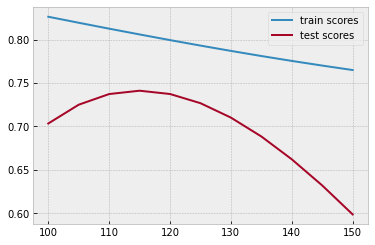

In [48]:
plt.plot(clips,train_scores,label="train scores")
plt.plot(clips, test_scores, label="test scores")
plt.legend()

mx_test = max(test_scores)
mx_idx = test_scores.index(mx_test)
train_mx_test = train_scores[mx_idx]
clip_mx = clips[mx_idx]
print("Train Score from max Test Score: ", train_mx_test, "\n",
      "Max Test Score: ", mx_test, "\n",
     "Achieved with {} upper clipped RUL".format(clip_mx))
lr_varclip_pol_TR_score = train_mx_test
lr_varclip_pol_TS_score = mx_test

## RF + polynomial features + combination top features & RUL clipped

In [50]:
clips = np.arange(100,135,5).tolist()
train_scores = []
test_scores = []

n_estimators = 93
max_depth = 20
min_samples_leaf = 17

for clip in clips:

    y_train_clip = df_train_3["RUL"].clip(upper=clip)
    
    regr = RandomForestRegressor(n_estimators=n_estimators, max_depth=max_depth, min_samples_leaf=min_samples_leaf)
    regr.fit(X_train_pol,y_train_clip)
    
    preds_train = regr.predict(X_train_pol)
    r2_tr = r2_score(y_train_clip, preds_train)
    train_scores.append(r2_tr)
    print(" TRAIN SCORE WITH {} upper clipped RUL: ".format(clip), r2_score(y_train_clip, preds_train))
    
    preds_test = regr.predict(X_test_pol)
    r2_ts = r2_score(y_test, preds_test)
    test_scores.append(r2_ts)
    print(" TEST SCORE WITH {} upper clipped RUL: ".format(clip), r2_score(y_testL, preds_test))

 TRAIN SCORE WITH 100 upper clipped RUL:  0.9105173281372576
 TEST SCORE WITH 100 upper clipped RUL:  0.7168898941510014
 TRAIN SCORE WITH 105 upper clipped RUL:  0.9069346582687926
 TEST SCORE WITH 105 upper clipped RUL:  0.740328135909544
 TRAIN SCORE WITH 110 upper clipped RUL:  0.9036837793167886
 TEST SCORE WITH 110 upper clipped RUL:  0.7570380388160066
 TRAIN SCORE WITH 115 upper clipped RUL:  0.89971081420018
 TEST SCORE WITH 115 upper clipped RUL:  0.7599274081478097
 TRAIN SCORE WITH 120 upper clipped RUL:  0.8959698610921106
 TEST SCORE WITH 120 upper clipped RUL:  0.7597654225930413
 TRAIN SCORE WITH 125 upper clipped RUL:  0.8916725856975
 TEST SCORE WITH 125 upper clipped RUL:  0.754728239333754
 TRAIN SCORE WITH 130 upper clipped RUL:  0.8878794031979695
 TEST SCORE WITH 130 upper clipped RUL:  0.7335341147486606


Train Score from max Test Score:  0.89971081420018 
 Max Test Score:  0.7599274081478097 
 Achieved with 115 upper clipped RUL


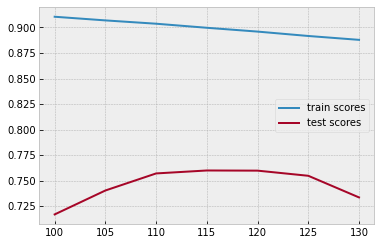

In [51]:
plt.plot(clips,train_scores,label="train scores")
plt.plot(clips, test_scores, label="test scores")
plt.legend()

mx_test = max(test_scores)
mx_idx = test_scores.index(mx_test)
train_mx_test = train_scores[mx_idx]
clip_mx = clips[mx_idx]
print("Train Score from max Test Score: ", train_mx_test, "\n",
      "Max Test Score: ", mx_test, "\n",
     "Achieved with {} upper clipped RUL".format(clip_mx))
lr_varclip_pol_TR_score = train_mx_test
lr_varclip_pol_TS_score = mx_test

## SVR + Polynomial Features + combination top features & RUL clipped

In [63]:
clips = np.arange(100,155,5).tolist()
train_scores = []
test_scores = []


for clip in clips:

    y_train_clip = df_train_3["RUL"].clip(upper=clip)
    svr = make_pipeline(StandardScaler(), SVR(epsilon=0.2))
    svr.fit(X_train_pol, y_train_clip)

    preds_train = svr.predict(X_train_pol)
    r2_tr = r2_score(y_train_clip, preds_train)
    train_scores.append(r2_tr)
    print(" TRAIN SCORE WITH {} upper clipped RUL: ".format(clip), r2_score(y_train_clip, preds_train))
    
    preds_test = svr.predict(X_test_pol)
    r2_ts = r2_score(y_test, preds_test)
    test_scores.append(r2_ts)
    print(" TEST SCORE WITH {} upper clipped RUL: ".format(clip), r2_score(y_testL, preds_test))

 TRAIN SCORE WITH 100 upper clipped RUL:  0.8534198518607894
 TEST SCORE WITH 100 upper clipped RUL:  0.7085245015666466
 TRAIN SCORE WITH 105 upper clipped RUL:  0.8474789084688068
 TEST SCORE WITH 105 upper clipped RUL:  0.7262017373903791
 TRAIN SCORE WITH 110 upper clipped RUL:  0.8417142977288518
 TEST SCORE WITH 110 upper clipped RUL:  0.7342276815930018
 TRAIN SCORE WITH 115 upper clipped RUL:  0.8355212805159469
 TEST SCORE WITH 115 upper clipped RUL:  0.7318959142990269
 TRAIN SCORE WITH 120 upper clipped RUL:  0.8294224468980824
 TEST SCORE WITH 120 upper clipped RUL:  0.7224004385722302
 TRAIN SCORE WITH 125 upper clipped RUL:  0.8232089112724713
 TEST SCORE WITH 125 upper clipped RUL:  0.7041725582551093
 TRAIN SCORE WITH 130 upper clipped RUL:  0.8166724910982892
 TEST SCORE WITH 130 upper clipped RUL:  0.6801794514253691
 TRAIN SCORE WITH 135 upper clipped RUL:  0.810459835017735
 TEST SCORE WITH 135 upper clipped RUL:  0.6522267188847056
 TRAIN SCORE WITH 140 upper clipp

Train Score from max Test Score:  0.8417142977288518 
 Max Test Score:  0.7342276815930018 
 Achieved with 110 upper clipped RUL


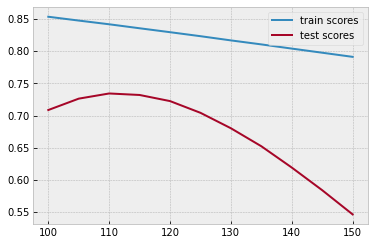

In [64]:
plt.plot(clips,train_scores,label="train scores")
plt.plot(clips, test_scores, label="test scores")
plt.legend()

mx_test = max(test_scores)
mx_idx = test_scores.index(mx_test)
train_mx_test = train_scores[mx_idx]
clip_mx = clips[mx_idx]
print("Train Score from max Test Score: ", train_mx_test, "\n",
      "Max Test Score: ", mx_test, "\n",
     "Achieved with {} upper clipped RUL".format(clip_mx))
lr_varclip_pol_TR_score = train_mx_test
lr_varclip_pol_TS_score = mx_test

This last loop has increased overall previous results from the three models, compared with fixed RUL. The best metric achieved previously was not beaten (with very small difference) and started to be close to overfit in the case of Random Forest. It is true that, if the GridSearch would have been entirely applied again, better metrics could have been seen, in any case, this FD003 regression problem ends with a notable final accuracy from the following final mode, determined as the best option in this study to be applied for engines performing at 1 flight condition (Sea Level) and expected to fall in two different failure categories (Fan and HPC deterioration):
-	A random forest regressor, optimised with a RandomizedSearchCV
        -	Max_depth = 20
        -	Min_samples_leaf = 17
        -	N_estimators = 93
-	Featured with lagged variables, filtered with top 20 features by slope.
-	Limiting the RUL from above at 120 cycles

This provides 0.890 r2 score for train set and 0.764 for test score
